# Proyecto FaceToPix

En este proyecto generaremos una versión de la imagen con formato pixelado, parecido a si fuera pixel-art. Para esto utilizaremos dos redes generativas utilizando la arquitectura [CycleGAN](https://www.youtube.com/watch?v=-8hfnlxEPn4).

## Entrenamiento

In [13]:

BASE_PATH = "drive/MyDrive/Universidad/Deep Learning/Proyecto FaceToPix"
# PIXEL_PATH = f"{BASE_PATH}/data/pyxel"
# SHARP_PATH = f"{BASE_PATH}/data/faces"
# PIXEL_PATH = f"{BASE_PATH}/data/sample_pyxel"
# PIXEL_PATH = f"{BASE_PATH}/Pixie"
PIXEL_PATH = f"{BASE_PATH}/data/clean_pix"
SHARP_PATH = f"{BASE_PATH}/data/sample_faces"

In [ ]:
# Transformar imágenes de prueba
#trainer.load_models('checkpoint_epoch_30.pth')

# De nítida a borrosa
#trainer.transform_image(f"{BASE_PATH}/data/del.jpg", f"{BASE_PATH}/data/del_pix.png", sharp_to_blur=True)

In [14]:
# !pip install ipympl

# %matplotlib inline
# %matplotlib ipympl

import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
import os
import time
import itertools

torch.autograd.set_detect_anomaly(True)

In [15]:
def weights_init_normal(m):
    classname = m.__class__.__name__
    if classname.find("Conv") != -1:
        torch.nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find("BatchNorm2d") != -1:
        torch.nn.init.normal_(m.weight.data, 1.0, 0.02)
        torch.nn.init.constant_(m.bias.data, 0.0)

# Generator Network (ResNet-based)
class ResidualBlock(nn.Module):
    def __init__(self, channels):
        super(ResidualBlock, self).__init__()
        self.block = nn.Sequential(
            nn.Conv2d(channels, channels, 3, padding=1),
            nn.InstanceNorm2d(channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(channels, channels, 3, padding=1),
            nn.InstanceNorm2d(channels),
        )

    def forward(self, x):
        return x + self.block(x)


class Generator(nn.Module):
    def __init__(self, input_channels=3, n_residual_blocks=9):
        super(Generator, self).__init__()

        # Initial convolution block
        model = [
            nn.Conv2d(input_channels, 64, 7, padding=3),
            nn.InstanceNorm2d(64),
            nn.ReLU(inplace=True),
        ]

        # Downsampling
        in_features = 64
        # 128
        out_features = in_features * 2
        for _ in range(2):
            model += [
                nn.Conv2d(in_features, out_features, 3, stride=2, padding=1),
                nn.InstanceNorm2d(out_features),
                nn.ReLU(inplace=True),
            ]
            # 128, 256
            in_features = out_features
            # 256, 512
            out_features = in_features * 2

        # Residual blocks
        for _ in range(n_residual_blocks):
            model += [ResidualBlock(in_features)]

        # Upsampling
        # 128
        out_features = in_features // 2
        for _ in range(2):
            model += [
                nn.ConvTranspose2d(
                    in_features, out_features, 3, stride=2, padding=1, output_padding=1
                ),
                nn.InstanceNorm2d(out_features),
                nn.ReLU(inplace=True),
            ]
            # 128, 64
            in_features = out_features
            # 128, 64
            out_features = in_features // 2

        # Output layer
        model += [nn.Conv2d(64, input_channels, 7, padding=3), nn.Tanh()]

        self.model = nn.Sequential(*model)

    def forward(self, x):
        return self.model(x)

class Discriminator(nn.Module):
    def __init__(self, input_nc=3):
        super(Discriminator, self).__init__()

        def discriminator_block(in_filters, out_filters, normalize=True):
            layers = [nn.Conv2d(in_filters, out_filters, 4, stride=2, padding=1)]
            if normalize:
                layers.append(nn.InstanceNorm2d(out_filters))
            layers.append(nn.LeakyReLU(0.2, inplace=True))
            return layers

        self.model = nn.Sequential(
            *discriminator_block(input_nc, 64, normalize=False),
            *discriminator_block(64, 128),
            *discriminator_block(128, 256),
            *discriminator_block(256, 512),
            nn.ZeroPad2d((1, 0, 1, 0)),
            nn.Conv2d(512, 1, 4, padding=1),
        )

    def forward(self, x):
        return self.model(x)


# Dataset class
class ImageDataset(Dataset):
    def __init__(
        self, root_normal, root_pixel, sharp_transform=None, pixel_transform=None
    ):
        self.sharp_transform = sharp_transform
        self.pixel_transform = pixel_transform
        self.files_normal = sorted(
            [
                os.path.join(root_normal, f)
                for f in os.listdir(root_normal)
                if f.endswith((".png", ".jpg", ".jpeg"))
            ]
        )
        self.files_pixel = sorted(
            [
                os.path.join(root_pixel, f)
                for f in os.listdir(root_pixel)
                if f.endswith((".png", ".jpg", ".jpeg"))
            ]
        )

        self.len_normal = len(self.files_normal)
        self.len_pixel = len(self.files_pixel)

    def __len__(self):
        return max(self.len_normal, self.len_pixel)

    def __getitem__(self, idx):
        normal_img = Image.open(self.files_normal[idx % self.len_normal]).convert("RGB")
        pixel_img = Image.open(self.files_pixel[idx % self.len_pixel]).convert("RGB")

        if self.sharp_transform:
            normal_img = self.sharp_transform(normal_img)
        if self.pixel_transform:
            pixel_img = self.pixel_transform(pixel_img)

        return {"normal": normal_img, "pixel": pixel_img}

class ReplayBuffer:
    def __init__(self, max_size=50):
        self.max_size = max_size
        self.data = []

    def push_and_pop(self, data):
        to_return = []
        for element in data.data:
            element = torch.unsqueeze(element, 0)
            if len(self.data) < self.max_size:
                self.data.append(element)
                to_return.append(element)
            else:
                if np.random.uniform(0, 1) > 0.5:
                    i = np.random.randint(0, self.max_size - 1)
                    to_return.append(self.data[i].clone())
                    self.data[i] = element
                else:
                    to_return.append(element)
        return torch.cat(to_return)

0...

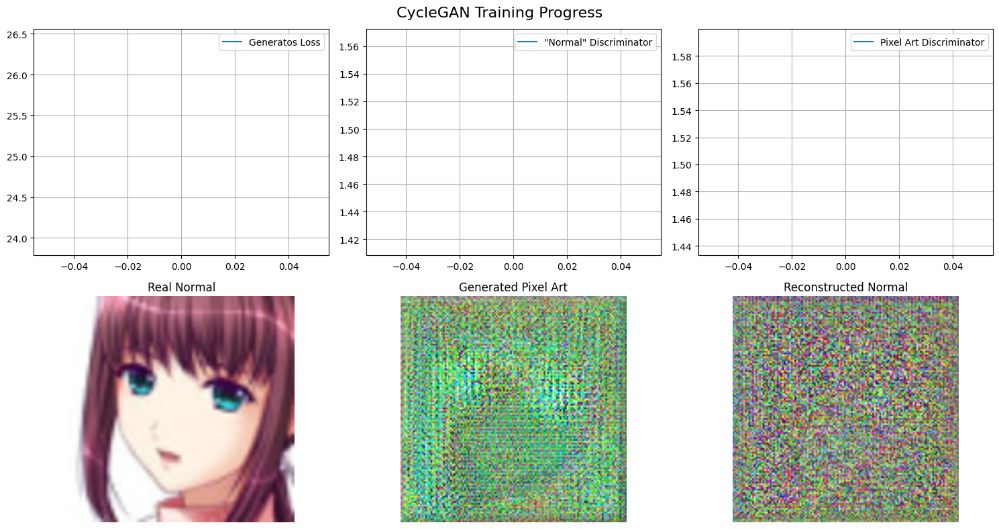

1...2...3...4...5...6...7...8...9...10...11...12...13...14...15...16...17...18...19...20...21...22...23...24...25...26...27...28...29...30...31...32...33...34...35...36...37...38...39...40...41...42...43...44...45...46...47...48...49...50...51...52...53...54...55...56...57...58...59...60...61...62...63...64...65...66...67...68...69...70...71...72...73...74...75...76...77...78...79...80...81...82...83...84...85...86...87...88...89...90...91...92...93...94...95...96...97...98...99...100...101...102...103...104...105...106...107...108...109...110...111...112...113...114...115...116...117...118...119...120...121...122...123...124...125...126...127...128...129...130...131...132...133...134...135...136...137...138...139...140...141...142...143...144...145...146...147...148...149...150...

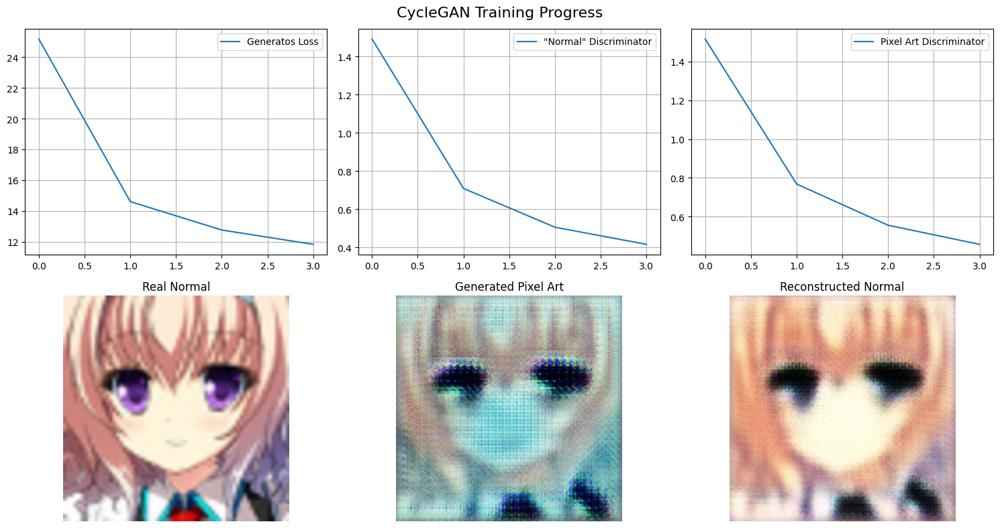

151...152...153...154...155...156...157...158...159...160...161...162...163...164...165...166...167...168...169...170...171...172...173...174...175...176...177...178...179...180...181...182...183...184...185...186...187...188...189...190...191...192...193...194...195...196...197...198...199...200...201...202...203...204...205...206...207...208...209...210...211...212...213...214...215...216...217...218...219...220...221...222...223...224...225...226...227...228...229...230...231...232...233...234...235...236...237...238...239...240...241...242...243...244...245...246...247...248...249...250...251...252...253...254...255...256...257...258...259...260...261...262...263...264...265...266...267...268...269...270...271...272...273...274...275...276...277...278...279...280...281...282...283...284...285...286...287...288...289...290...291...292...293...294...295...296...297...298...299...300...

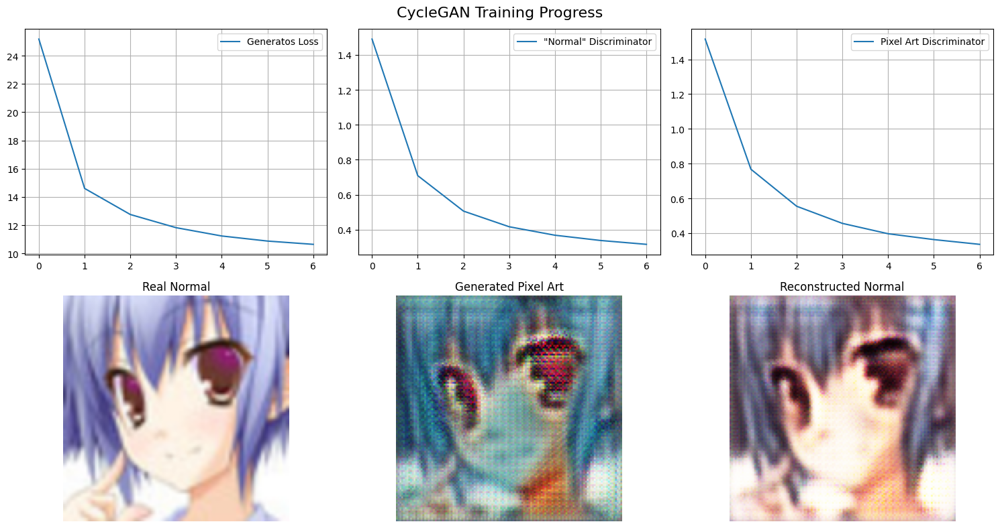

301...302...303...304...305...306...307...308...309...310...311...312...313...314...315...316...317...318...319...320...321...322...323...324...325...326...327...328...329...330...331...332...333...334...335...336...337...338...339...340...341...342...343...344...345...346...347...348...349...350...351...352...353...354...355...356...357...358...359...360...361...362...
Epoch [1/50] (363 imgs, took: 206.7s)- G: 10.3335, D_Normal: 0.2931, D_Pixel: 0.3135
0...

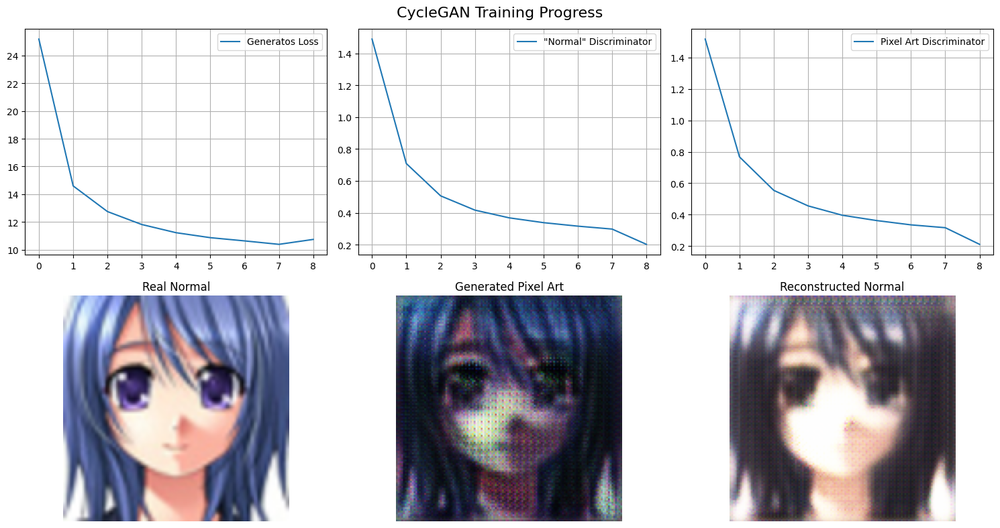

1...2...3...4...5...6...7...8...9...10...11...12...13...14...15...16...17...18...19...20...21...22...23...24...25...26...27...28...29...30...31...32...33...34...35...36...37...38...39...40...41...42...43...44...45...46...47...48...49...50...51...52...53...54...55...56...57...58...59...60...61...62...63...64...65...66...67...68...69...70...71...72...73...74...75...76...77...78...79...80...81...82...83...84...85...86...87...88...89...90...91...92...93...94...95...96...97...98...99...100...101...102...103...104...105...106...107...108...109...110...111...112...113...114...115...116...117...118...119...120...121...122...123...124...125...126...127...128...129...130...131...132...133...134...135...136...137...138...139...140...141...142...143...144...145...146...147...148...149...150...

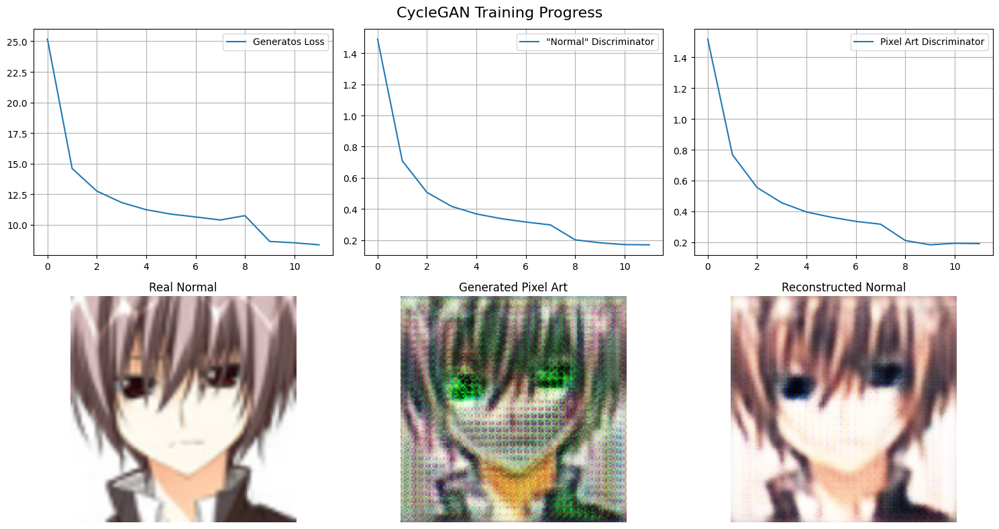

151...152...153...154...155...156...157...158...159...160...161...162...163...164...165...166...167...168...169...170...171...172...173...174...175...176...177...178...179...180...181...182...183...184...185...186...187...188...189...190...191...192...193...194...195...196...197...198...199...200...201...202...203...204...205...206...207...208...209...210...211...212...213...214...215...216...217...218...219...220...221...222...223...224...225...226...227...228...229...230...231...232...233...234...235...236...237...238...239...240...241...242...243...244...245...246...247...248...249...250...251...252...253...254...255...256...257...258...259...260...261...262...263...264...265...266...267...268...269...270...271...272...273...274...275...276...277...278...279...280...281...282...283...284...285...286...287...288...289...290...291...292...293...294...295...296...297...298...299...300...

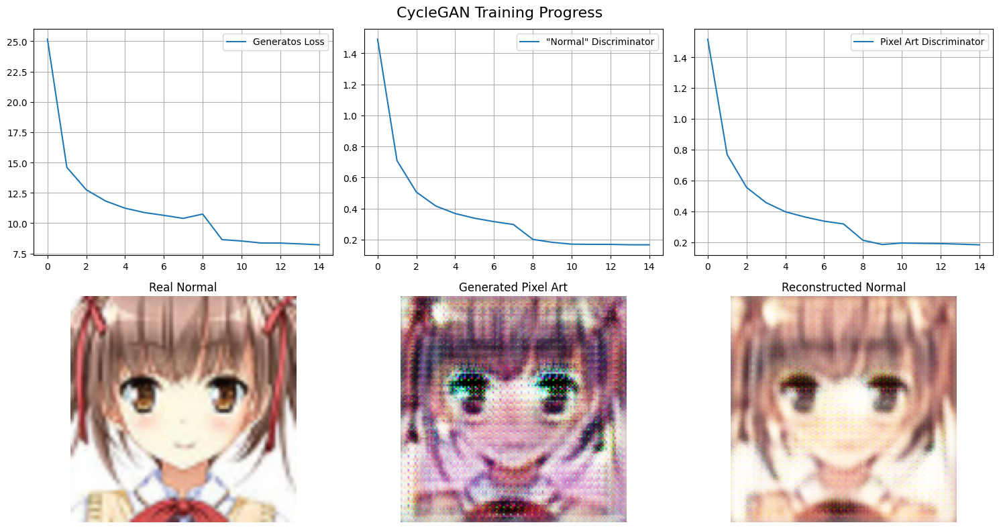

301...302...303...304...305...306...307...308...309...310...311...312...313...314...315...316...317...318...319...320...321...322...323...324...325...326...327...328...329...330...331...332...333...334...335...336...337...338...339...340...341...342...343...344...345...346...347...348...349...350...351...352...353...354...355...356...357...358...359...360...361...362...
Epoch [2/50] (363 imgs, took: 207.7s)- G: 8.1615, D_Normal: 0.1667, D_Pixel: 0.1788
0...

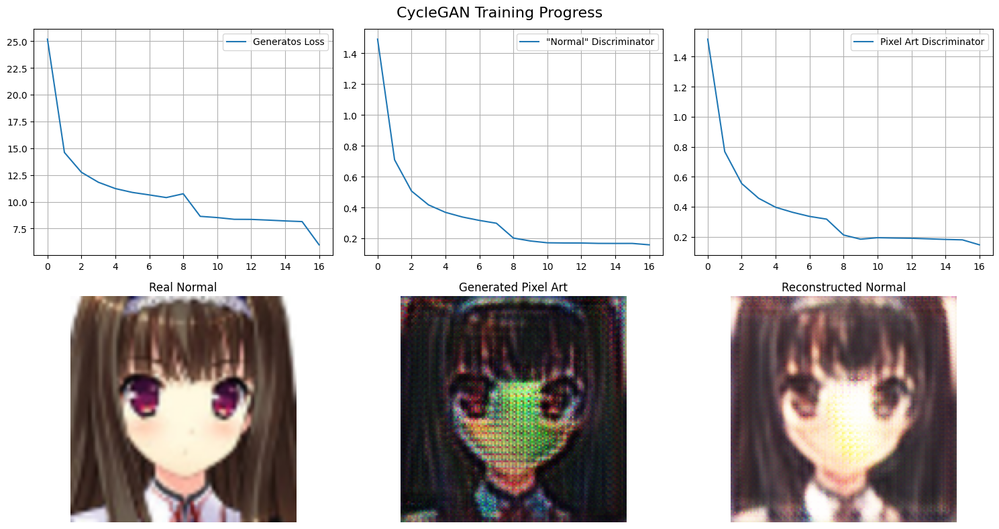

1...2...3...4...5...6...7...8...9...10...11...12...13...14...15...16...17...18...19...20...21...22...23...24...25...26...27...28...29...30...31...32...33...34...35...36...37...38...39...40...41...42...43...44...45...46...47...48...49...50...51...52...53...54...55...56...57...58...59...60...61...62...63...64...65...66...67...68...69...70...71...72...73...74...75...76...77...78...79...80...81...82...83...84...85...86...87...88...89...90...91...92...93...94...95...96...97...98...99...100...101...102...103...104...105...106...107...108...109...110...111...112...113...114...115...116...117...118...119...120...121...122...123...124...125...126...127...128...129...130...131...132...133...134...135...136...137...138...139...140...141...142...143...144...145...146...147...148...149...150...

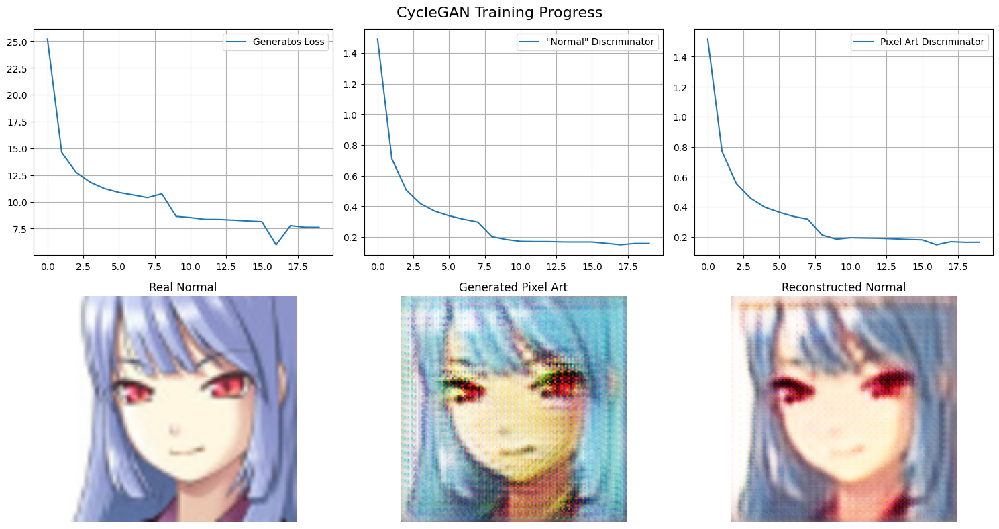

151...152...153...154...155...156...157...158...159...160...161...162...163...164...165...166...167...168...169...170...171...172...173...174...175...176...177...178...179...180...181...182...183...184...185...186...187...188...189...190...191...192...193...194...195...196...197...198...199...200...201...202...203...204...205...206...207...208...209...210...211...212...213...214...215...216...217...218...219...220...221...222...223...224...225...226...227...228...229...230...231...232...233...234...235...236...237...238...239...240...241...242...243...244...245...246...247...248...249...250...251...252...253...254...255...256...257...258...259...260...261...262...263...264...265...266...267...268...269...270...271...272...273...274...275...276...277...278...279...280...281...282...283...284...285...286...287...288...289...290...291...292...293...294...295...296...297...298...299...300...

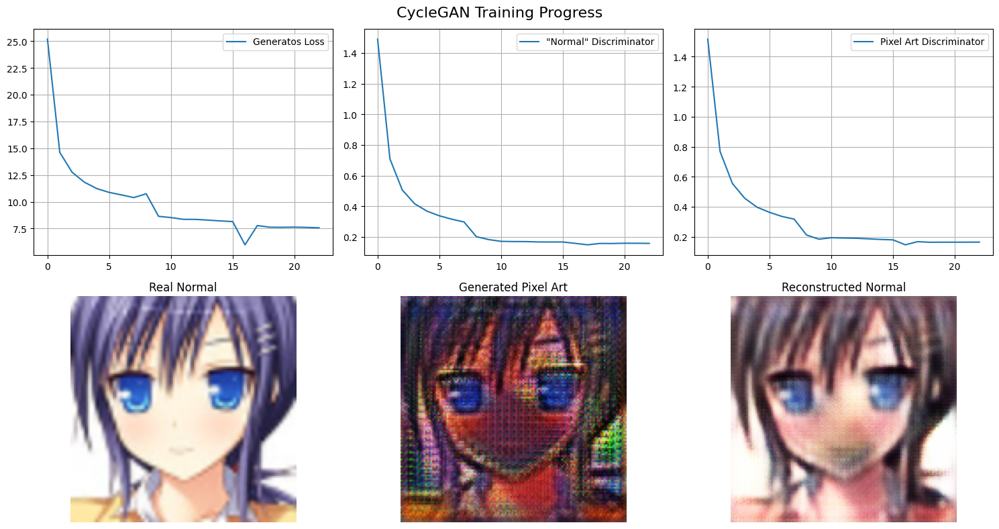

301...302...303...304...305...306...307...308...309...310...311...312...313...314...315...316...317...318...319...320...321...322...323...324...325...326...327...328...329...330...331...332...333...334...335...336...337...338...339...340...341...342...343...344...345...346...347...348...349...350...351...352...353...354...355...356...357...358...359...360...361...362...
Epoch [3/50] (363 imgs, took: 207.2s)- G: 7.5868, D_Normal: 0.1538, D_Pixel: 0.1637
0...

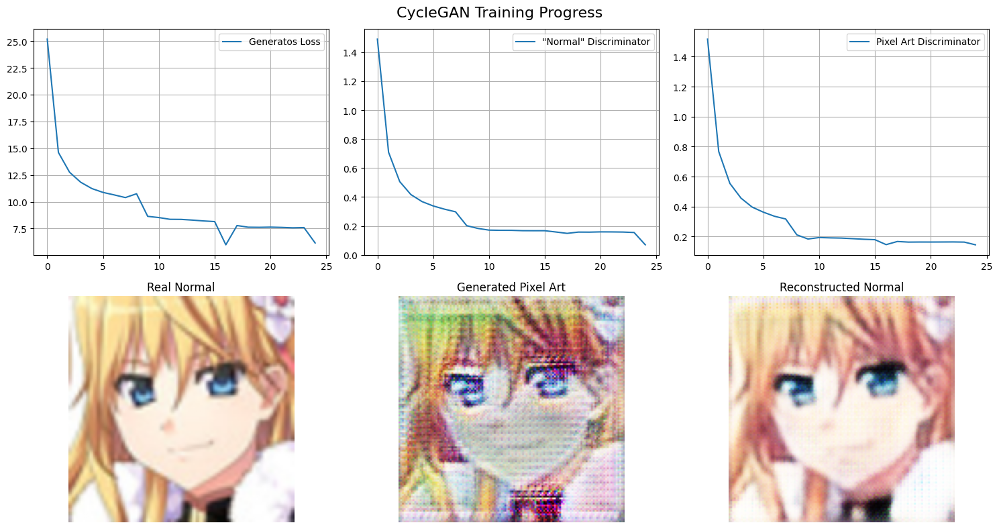

1...2...3...4...5...6...7...8...9...10...11...12...13...14...15...16...17...18...19...20...21...22...23...24...25...26...27...28...29...30...31...32...33...34...35...36...37...38...39...40...41...42...43...44...45...46...47...48...49...50...51...52...53...54...55...56...57...58...59...60...61...62...63...64...65...66...67...68...69...70...71...72...73...74...75...76...77...78...79...80...81...82...83...84...85...86...87...88...89...90...91...92...93...94...95...96...97...98...99...100...101...102...103...104...105...106...107...108...109...110...111...112...113...114...115...116...117...118...119...120...121...122...123...124...125...126...127...128...129...130...131...132...133...134...135...136...137...138...139...140...141...142...143...144...145...146...147...148...149...150...

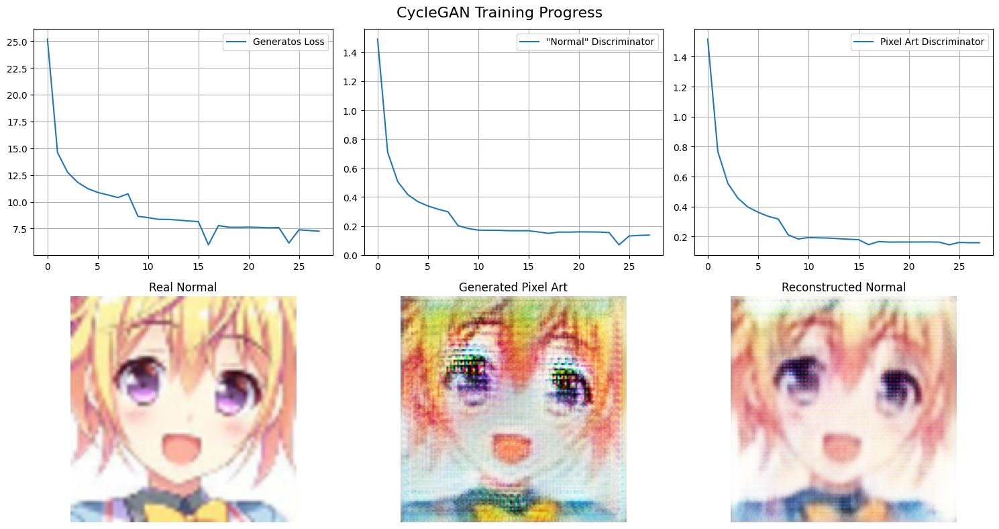

151...152...153...154...155...156...157...158...159...160...161...162...163...164...165...166...167...168...169...170...171...172...173...174...175...176...177...178...179...180...181...182...183...184...185...186...187...188...189...190...191...192...193...194...195...196...197...198...199...200...201...202...203...204...205...206...207...208...209...210...211...212...213...214...215...216...217...218...219...220...221...222...223...224...225...226...227...228...229...230...231...232...233...234...235...236...237...238...239...240...241...242...243...244...245...246...247...248...249...250...251...252...253...254...255...256...257...258...259...260...261...262...263...264...265...266...267...268...269...270...271...272...273...274...275...276...277...278...279...280...281...282...283...284...285...286...287...288...289...290...291...292...293...294...295...296...297...298...299...300...

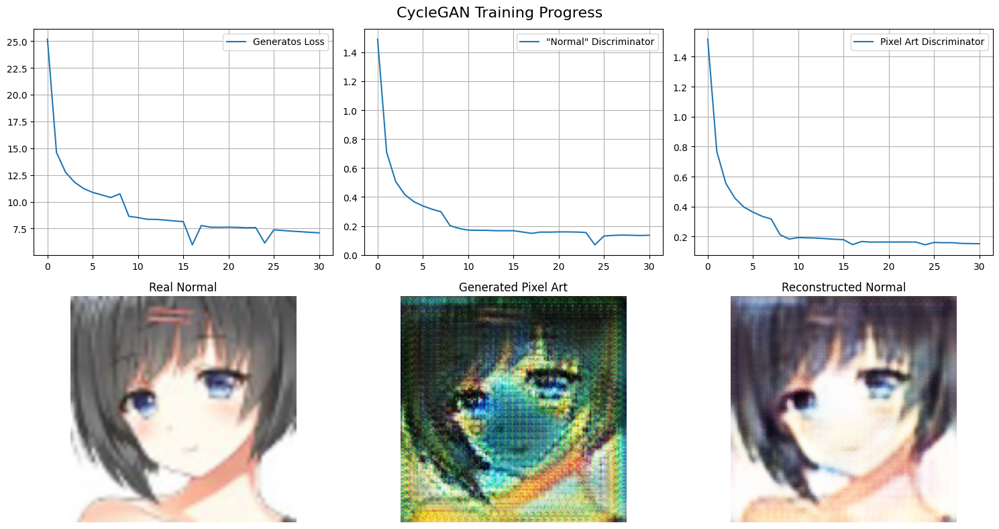

301...302...303...304...305...306...307...308...309...310...311...312...313...314...315...316...317...318...319...320...321...322...323...324...325...326...327...328...329...330...331...332...333...334...335...336...337...338...339...340...341...342...343...344...345...346...347...348...349...350...351...352...353...354...355...356...357...358...359...360...361...362...
Epoch [4/50] (363 imgs, took: 207.0s)- G: 7.1046, D_Normal: 0.1345, D_Pixel: 0.1511
0...

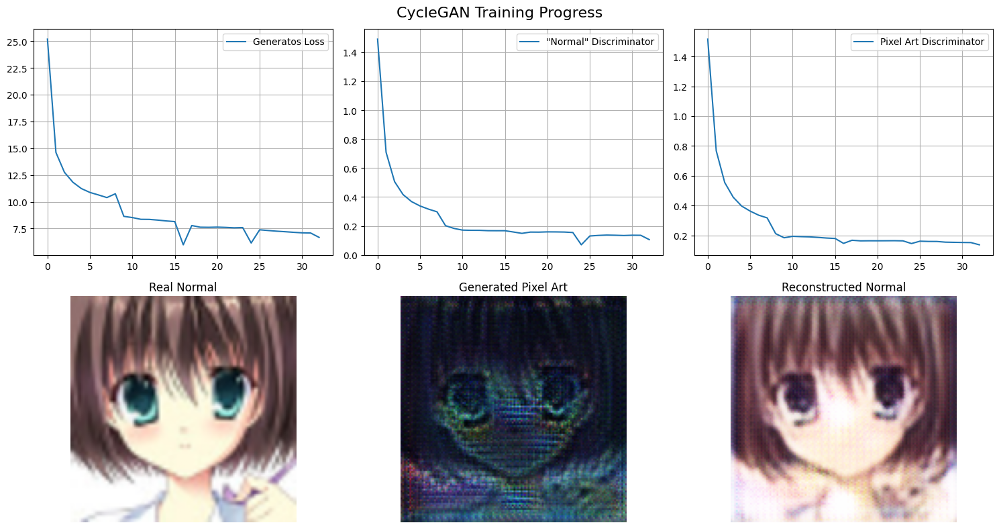

1...2...3...4...5...6...7...8...9...10...11...12...13...14...15...16...17...18...19...20...21...22...23...24...25...26...27...28...29...30...31...32...33...34...35...36...37...38...39...40...41...42...43...44...45...46...47...48...49...50...51...52...53...54...55...56...57...58...59...60...61...62...63...64...65...66...67...68...69...70...71...72...73...74...75...76...77...78...79...80...81...82...83...84...85...86...87...88...89...90...91...92...93...94...95...96...97...98...99...100...101...102...103...104...105...106...107...108...109...110...111...112...113...114...115...116...117...118...119...120...121...122...123...124...125...126...127...128...129...130...131...132...133...134...135...136...137...138...139...140...141...142...143...144...145...146...147...148...149...150...

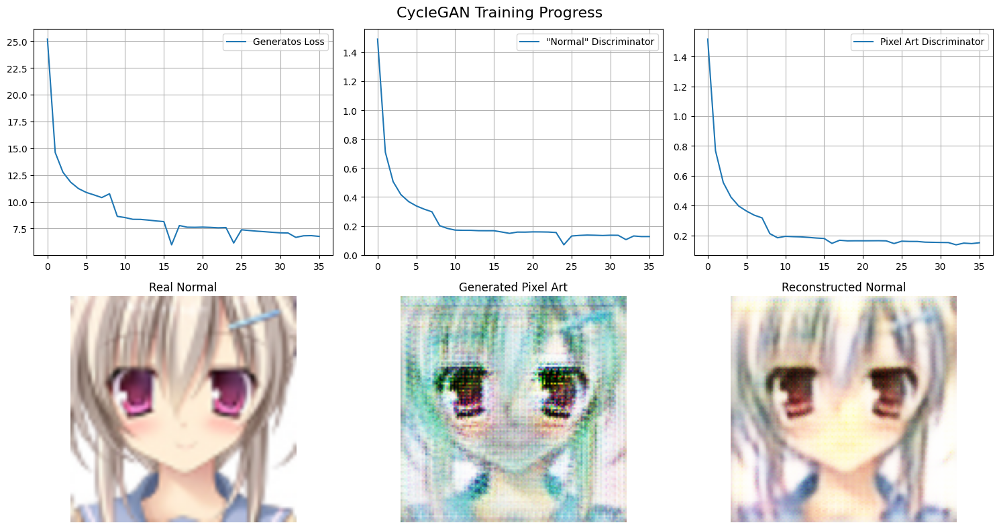

151...152...153...154...155...156...157...158...159...160...161...162...163...164...165...166...167...168...169...170...171...172...173...174...175...176...177...178...179...180...181...182...183...184...185...186...187...188...189...190...191...192...193...194...195...196...197...198...199...200...201...202...203...204...205...206...207...208...209...210...211...212...213...214...215...216...217...218...219...220...221...222...223...224...225...226...227...228...229...230...231...232...233...234...235...236...237...238...239...240...241...242...243...244...245...246...247...248...249...250...251...252...253...254...255...256...257...258...259...260...261...262...263...264...265...266...267...268...269...270...271...272...273...274...275...276...277...278...279...280...281...282...283...284...285...286...287...288...289...290...291...292...293...294...295...296...297...298...299...300...

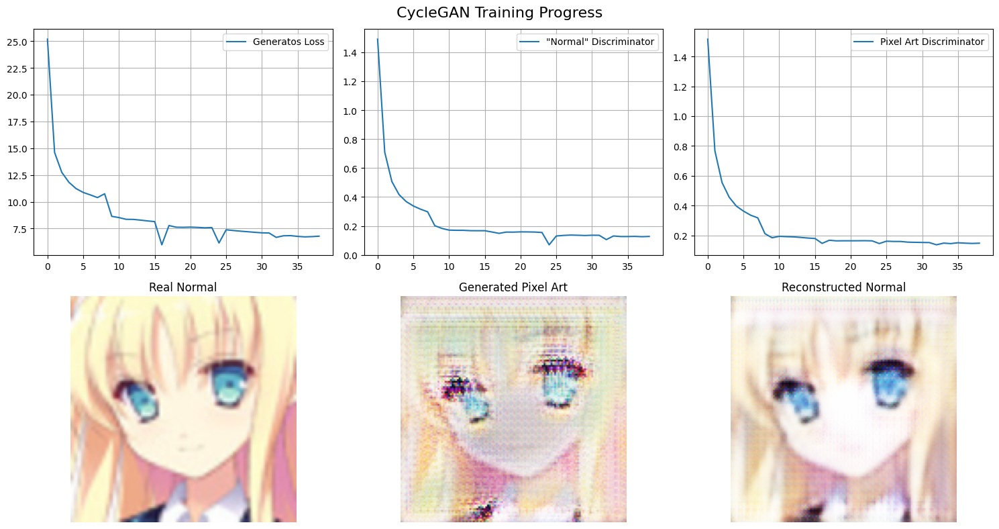

301...302...303...304...305...306...307...308...309...310...311...312...313...314...315...316...317...318...319...320...321...322...323...324...325...326...327...328...329...330...331...332...333...334...335...336...337...338...339...340...341...342...343...344...345...346...347...348...349...350...351...352...353...354...355...356...357...358...359...360...361...362...
Epoch [5/50] (363 imgs, took: 207.6s)- G: 6.8096, D_Normal: 0.1235, D_Pixel: 0.1465
Modelos guardados en drive/MyDrive/Universidad/Deep Learning/Proyecto FaceToPix/checkpoints/checkpoint_epoch_5.pth
0...

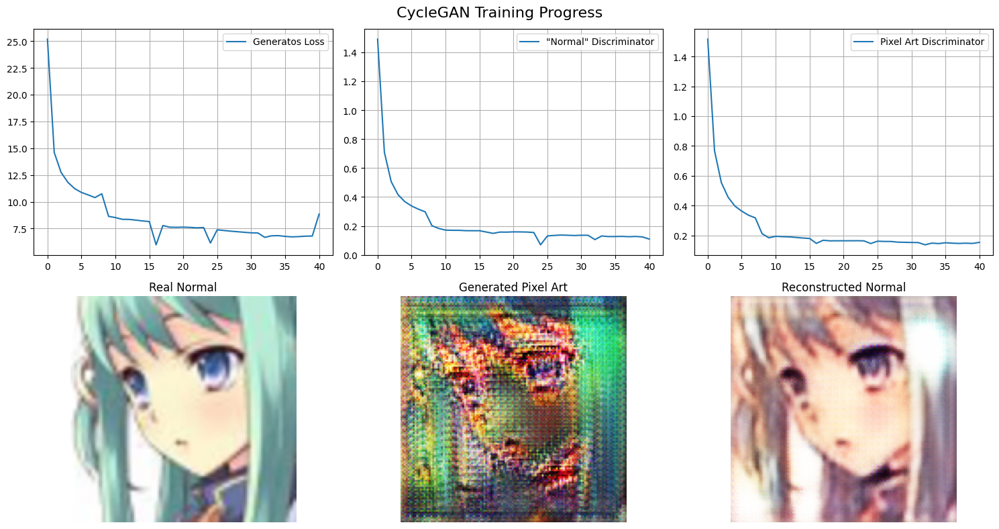

1...2...3...4...5...6...7...8...9...10...11...12...13...14...15...16...17...18...19...20...21...22...23...24...25...26...27...28...29...30...31...32...33...34...35...36...37...38...39...40...41...42...43...44...45...46...47...48...49...50...51...52...53...54...55...56...57...58...59...60...61...62...63...64...65...66...67...68...69...70...71...72...73...74...75...76...77...78...79...80...81...82...83...84...85...86...87...88...89...90...91...92...93...94...95...96...97...98...99...100...101...102...103...104...105...106...107...108...109...110...111...112...113...114...115...116...117...118...119...120...121...122...123...124...125...126...127...128...129...130...131...132...133...134...135...136...137...138...139...140...141...142...143...144...145...146...147...148...149...150...

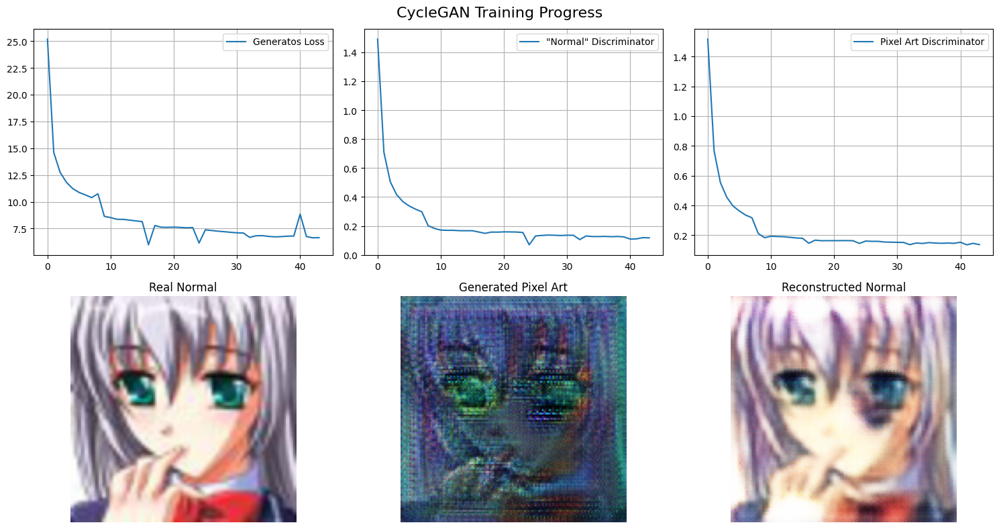

151...152...153...154...155...156...157...158...159...160...161...162...163...164...165...166...167...168...169...170...171...172...173...174...175...176...177...178...179...180...181...182...183...184...185...186...187...188...189...190...191...192...193...194...195...196...197...198...199...200...201...202...203...204...205...206...207...208...209...210...211...212...213...214...215...216...217...218...219...220...221...222...223...224...225...226...227...228...229...230...231...232...233...234...235...236...237...238...239...240...241...242...243...244...245...246...247...248...249...250...251...252...253...254...255...256...257...258...259...260...261...262...263...264...265...266...267...268...269...270...271...272...273...274...275...276...277...278...279...280...281...282...283...284...285...286...287...288...289...290...291...292...293...294...295...296...297...298...299...300...

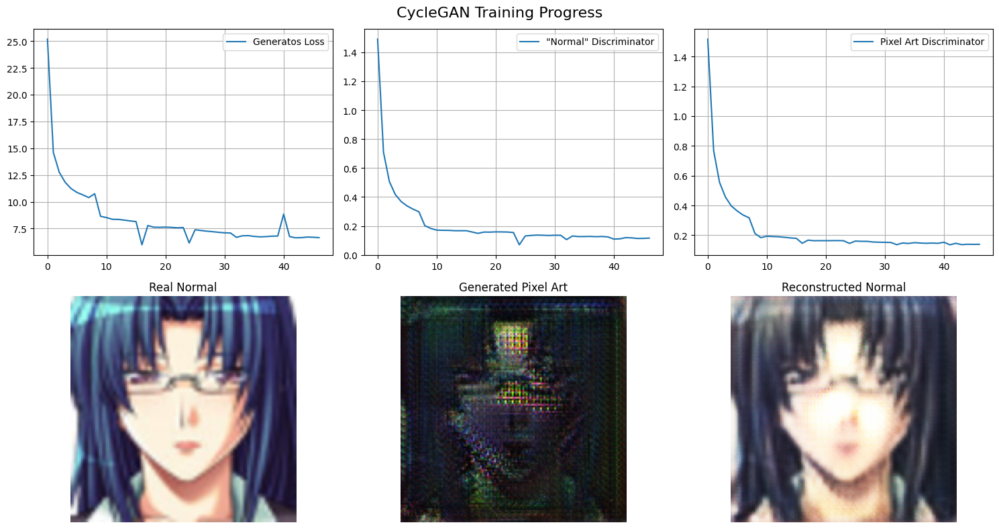

301...302...303...304...305...306...307...308...309...310...311...312...313...314...315...316...317...318...319...320...321...322...323...324...325...326...327...328...329...330...331...332...333...334...335...336...337...338...339...340...341...342...343...344...345...346...347...348...349...350...351...352...353...354...355...356...357...358...359...360...361...362...
Epoch [6/50] (363 imgs, took: 207.5s)- G: 6.6349, D_Normal: 0.1157, D_Pixel: 0.1390
0...

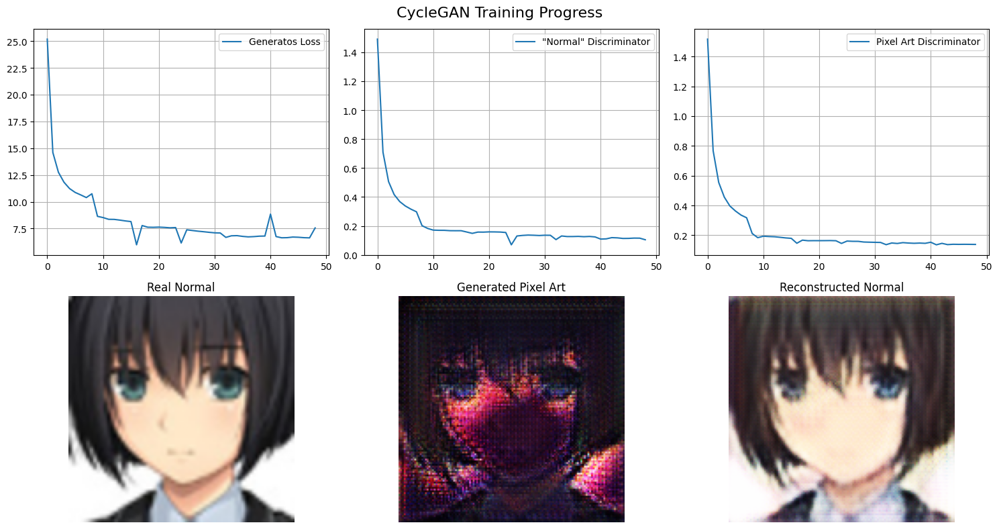

1...2...3...4...5...6...7...8...9...10...11...12...13...14...15...16...17...18...19...20...21...22...23...24...25...26...27...28...29...30...31...32...33...34...35...36...37...38...39...40...41...42...43...44...45...46...47...48...49...50...51...52...53...54...55...56...57...58...59...60...61...62...63...64...65...66...67...68...69...70...71...72...73...74...75...76...77...78...79...80...81...82...83...84...85...86...87...88...89...90...91...92...93...94...95...96...97...98...99...100...101...102...103...104...105...106...107...108...109...110...111...112...113...114...115...116...117...118...119...120...121...122...123...124...125...126...127...128...129...130...131...132...133...134...135...136...137...138...139...140...141...142...143...144...145...146...147...148...149...150...

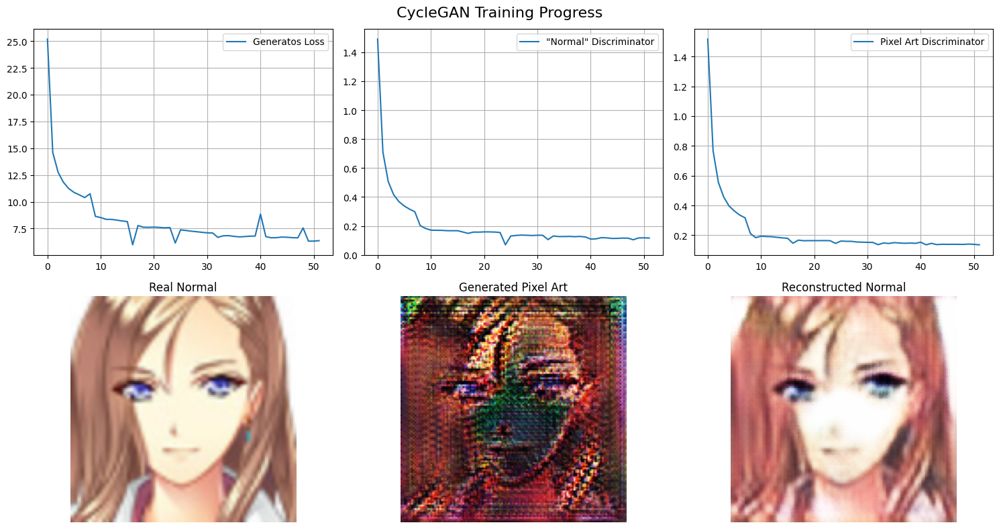

151...152...153...154...155...156...157...158...159...160...161...162...163...164...165...166...167...168...169...170...171...172...173...174...175...176...177...178...179...180...181...182...183...184...185...186...187...188...189...190...191...192...193...194...195...196...197...198...199...200...201...202...203...204...205...206...207...208...209...210...211...212...213...214...215...216...217...218...219...220...221...222...223...224...225...226...227...228...229...230...231...232...233...234...235...236...237...238...239...240...241...242...243...244...245...246...247...248...249...250...251...252...253...254...255...256...257...258...259...260...261...262...263...264...265...266...267...268...269...270...271...272...273...274...275...276...277...278...279...280...281...282...283...284...285...286...287...288...289...290...291...292...293...294...295...296...297...298...299...300...

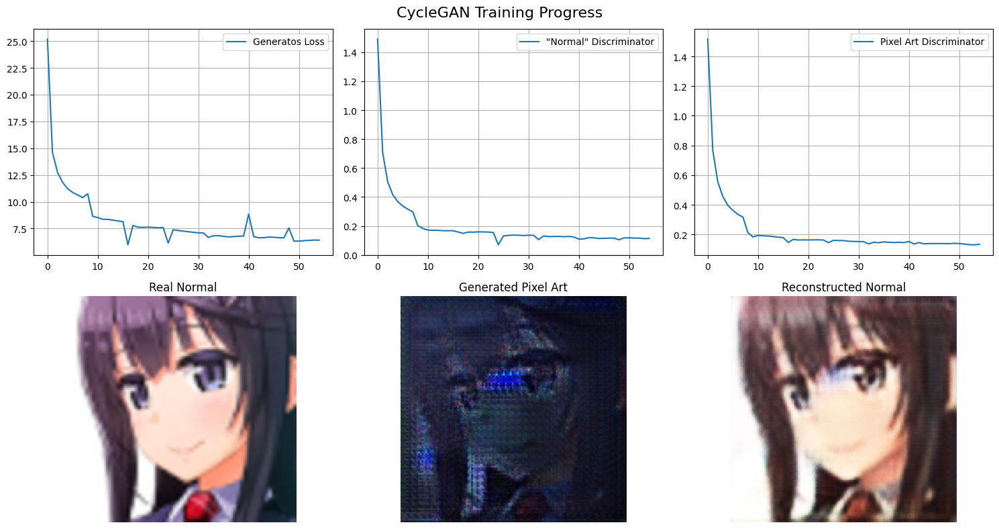

301...302...303...304...305...306...307...308...309...310...311...312...313...314...315...316...317...318...319...320...321...322...323...324...325...326...327...328...329...330...331...332...333...334...335...336...337...338...339...340...341...342...343...344...345...346...347...348...349...350...351...352...353...354...355...356...357...358...359...360...361...362...
Epoch [7/50] (363 imgs, took: 207.2s)- G: 6.3904, D_Normal: 0.1126, D_Pixel: 0.1335
0...

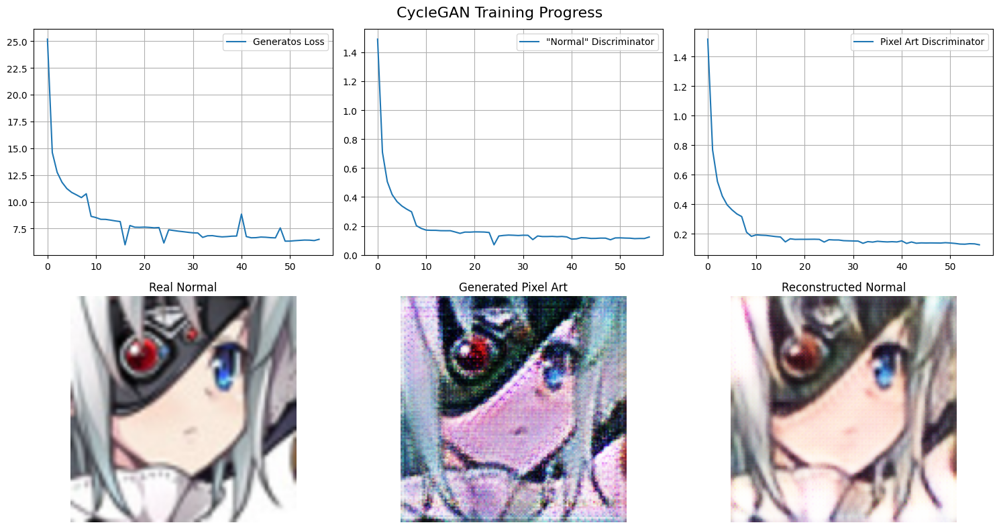

1...2...3...4...5...6...7...8...9...10...11...12...13...14...15...16...17...18...19...20...21...22...23...24...25...26...27...28...29...30...31...32...33...34...35...36...37...38...39...40...41...42...43...44...45...46...47...48...49...50...51...52...53...54...55...56...57...58...59...60...61...62...63...64...65...66...67...68...69...70...71...72...73...74...75...76...77...78...79...80...81...82...83...84...85...86...87...88...89...90...91...92...93...94...95...96...97...98...99...100...101...102...103...104...105...106...107...108...109...110...111...112...113...114...115...116...117...118...119...120...121...122...123...124...125...126...127...128...129...130...131...132...133...134...135...136...137...138...139...140...141...142...143...144...145...146...147...148...149...150...

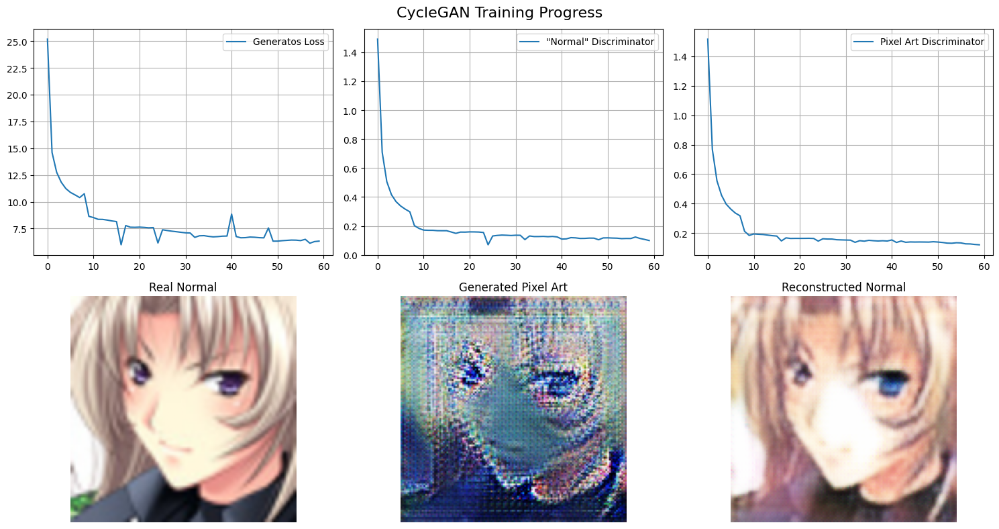

151...152...153...154...155...156...157...158...159...160...161...162...163...164...165...166...167...168...169...170...171...172...173...174...175...176...177...178...179...180...181...182...183...184...185...186...187...188...189...190...191...192...193...194...195...196...197...198...199...200...201...202...203...204...205...206...207...208...209...210...211...212...213...214...215...216...217...218...219...220...221...222...223...224...225...226...227...228...229...230...231...232...233...234...235...236...237...238...239...240...241...242...243...244...245...246...247...248...249...250...251...252...253...254...255...256...257...258...259...260...261...262...263...264...265...266...267...268...269...270...271...272...273...274...275...276...277...278...279...280...281...282...283...284...285...286...287...288...289...290...291...292...293...294...295...296...297...298...299...300...

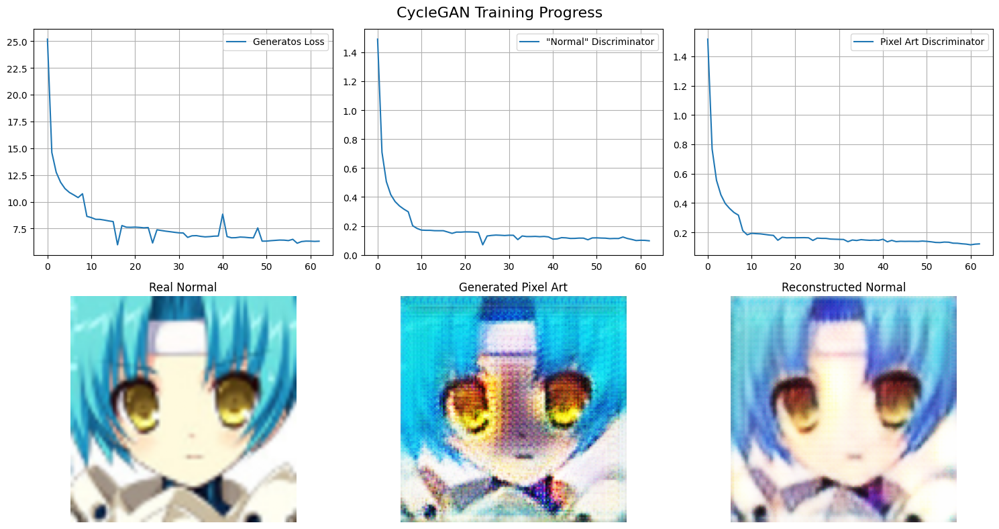

301...302...303...304...305...306...307...308...309...310...311...312...313...314...315...316...317...318...319...320...321...322...323...324...325...326...327...328...329...330...331...332...333...334...335...336...337...338...339...340...341...342...343...344...345...346...347...348...349...350...351...352...353...354...355...356...357...358...359...360...361...362...
Epoch [8/50] (363 imgs, took: 207.2s)- G: 6.2923, D_Normal: 0.1000, D_Pixel: 0.1228
0...

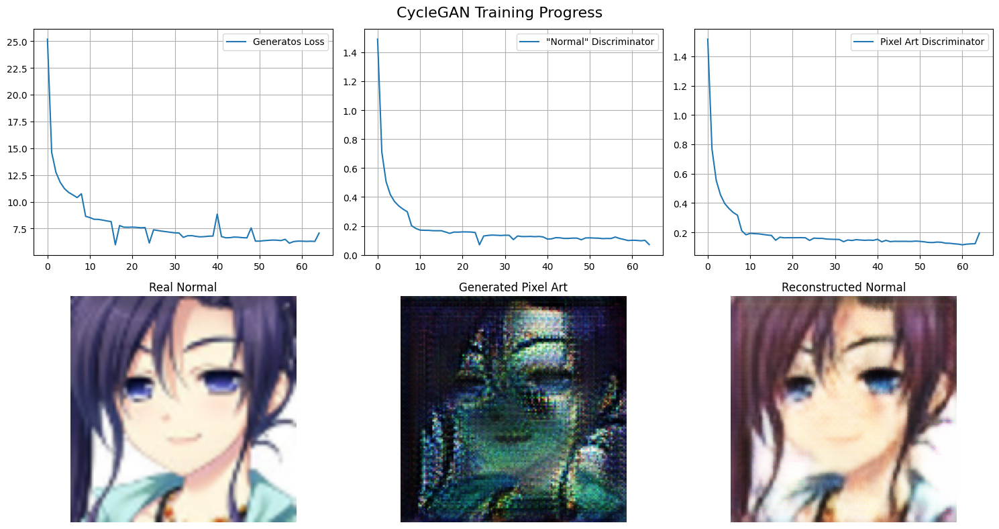

1...2...3...4...5...6...7...8...9...10...11...12...13...14...15...16...17...18...19...20...21...22...23...24...25...26...27...28...29...30...31...32...33...34...35...36...37...38...39...40...41...42...43...44...45...46...47...48...49...50...51...52...53...54...55...56...57...58...59...60...61...62...63...64...65...66...67...68...69...70...71...72...73...74...75...76...77...78...79...80...81...82...83...84...85...86...87...88...89...90...91...92...93...94...95...96...97...98...99...100...101...102...103...104...105...106...107...108...109...110...111...112...113...114...115...116...117...118...119...120...121...122...123...124...125...126...127...128...129...130...131...132...133...134...135...136...137...138...139...140...141...142...143...144...145...146...147...148...149...150...

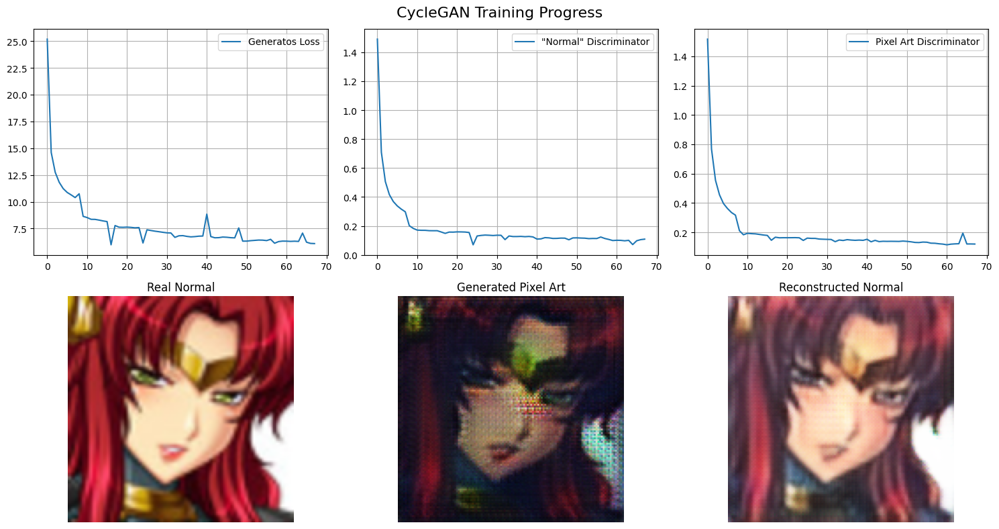

151...152...153...154...155...156...157...158...159...160...161...162...163...164...165...166...167...168...169...170...171...172...173...174...175...176...177...178...179...180...181...182...183...184...185...186...187...188...189...190...191...192...193...194...195...196...197...198...199...200...201...202...203...204...205...206...207...208...209...210...211...212...213...214...215...216...217...218...219...220...221...222...223...224...225...226...227...228...229...230...231...232...233...234...235...236...237...238...239...240...241...242...243...244...245...246...247...248...249...250...251...252...253...254...255...256...257...258...259...260...261...262...263...264...265...266...267...268...269...270...271...272...273...274...275...276...277...278...279...280...281...282...283...284...285...286...287...288...289...290...291...292...293...294...295...296...297...298...299...300...

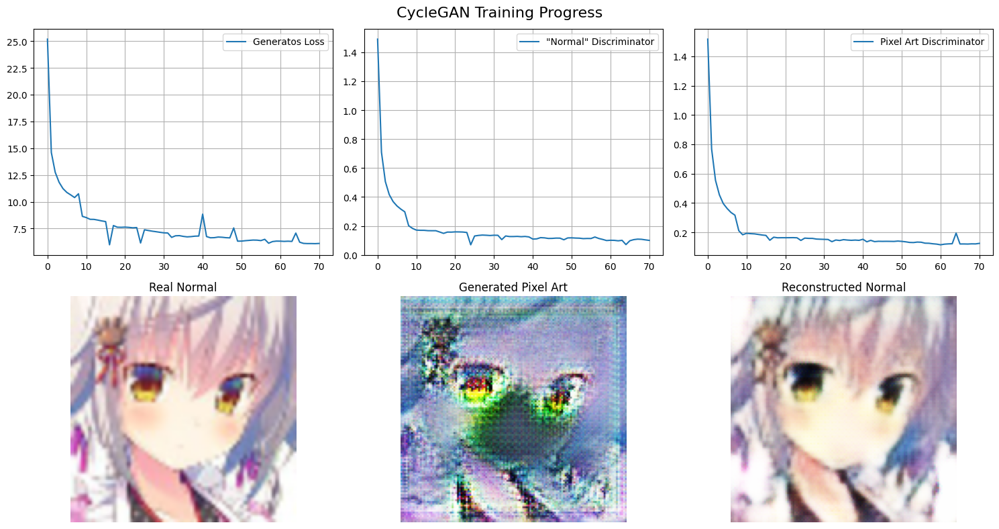

301...302...303...304...305...306...307...308...309...310...311...312...313...314...315...316...317...318...319...320...321...322...323...324...325...326...327...328...329...330...331...332...333...334...335...336...337...338...339...340...341...342...343...344...345...346...347...348...349...350...351...352...353...354...355...356...357...358...359...360...361...362...
Epoch [9/50] (363 imgs, took: 207.5s)- G: 6.1062, D_Normal: 0.0974, D_Pixel: 0.1248
0...

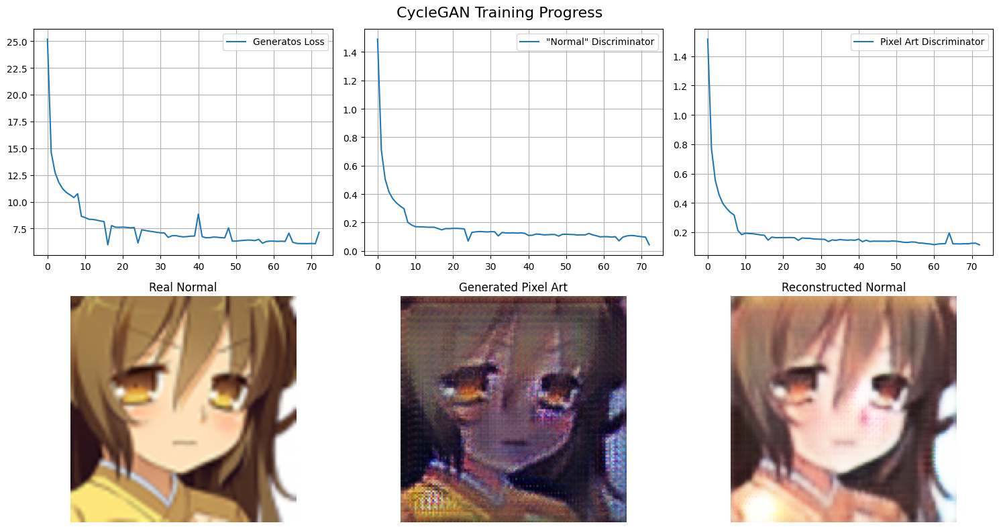

1...2...3...4...5...6...7...8...9...10...11...12...13...14...15...16...17...18...19...20...21...22...23...24...25...26...27...28...29...30...31...32...33...34...35...36...37...38...39...40...41...42...43...44...45...46...47...48...49...50...51...52...53...54...55...56...57...58...59...60...61...62...63...64...65...66...67...68...69...70...71...72...73...74...75...76...77...78...79...80...81...82...83...84...85...86...87...88...89...90...91...92...93...94...95...96...97...98...99...100...101...102...103...104...105...106...107...108...109...110...111...112...113...114...115...116...117...118...119...120...121...122...123...124...125...126...127...128...129...130...131...132...133...134...135...136...137...138...139...140...141...142...143...144...145...146...147...148...149...150...

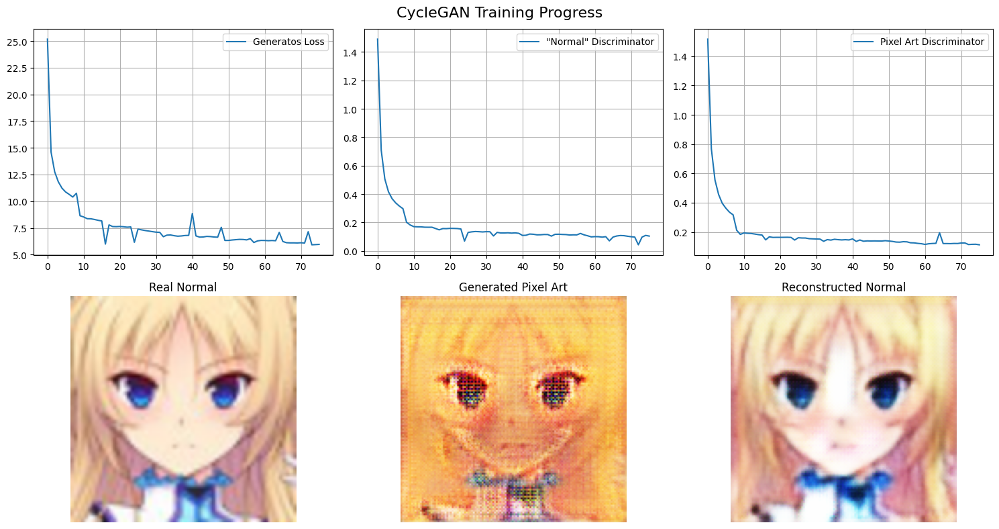

151...152...153...154...155...156...157...158...159...160...161...162...163...164...165...166...167...168...169...170...171...172...173...174...175...176...177...178...179...180...181...182...183...184...185...186...187...188...189...190...191...192...193...194...195...196...197...198...199...200...201...202...203...204...205...206...207...208...209...210...211...212...213...214...215...216...217...218...219...220...221...222...223...224...225...226...227...228...229...230...231...232...233...234...235...236...237...238...239...240...241...242...243...244...245...246...247...248...249...250...251...252...253...254...255...256...257...258...259...260...261...262...263...264...265...266...267...268...269...270...271...272...273...274...275...276...277...278...279...280...281...282...283...284...285...286...287...288...289...290...291...292...293...294...295...296...297...298...299...300...

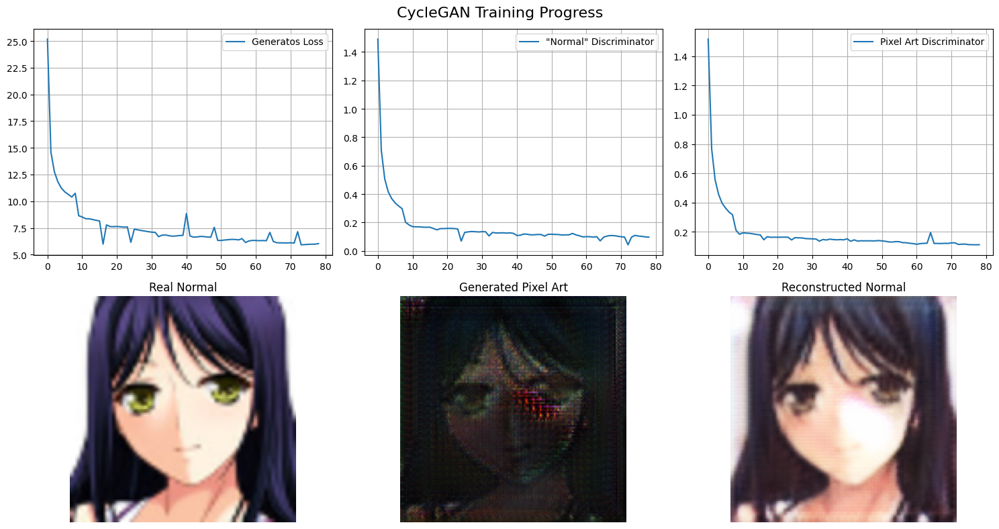

301...302...303...304...305...306...307...308...309...310...311...312...313...314...315...316...317...318...319...320...321...322...323...324...325...326...327...328...329...330...331...332...333...334...335...336...337...338...339...340...341...342...343...344...345...346...347...348...349...350...351...352...353...354...355...356...357...358...359...360...361...362...
Epoch [10/50] (363 imgs, took: 207.2s)- G: 6.0463, D_Normal: 0.0945, D_Pixel: 0.1125
Modelos guardados en drive/MyDrive/Universidad/Deep Learning/Proyecto FaceToPix/checkpoints/checkpoint_epoch_10.pth
0...

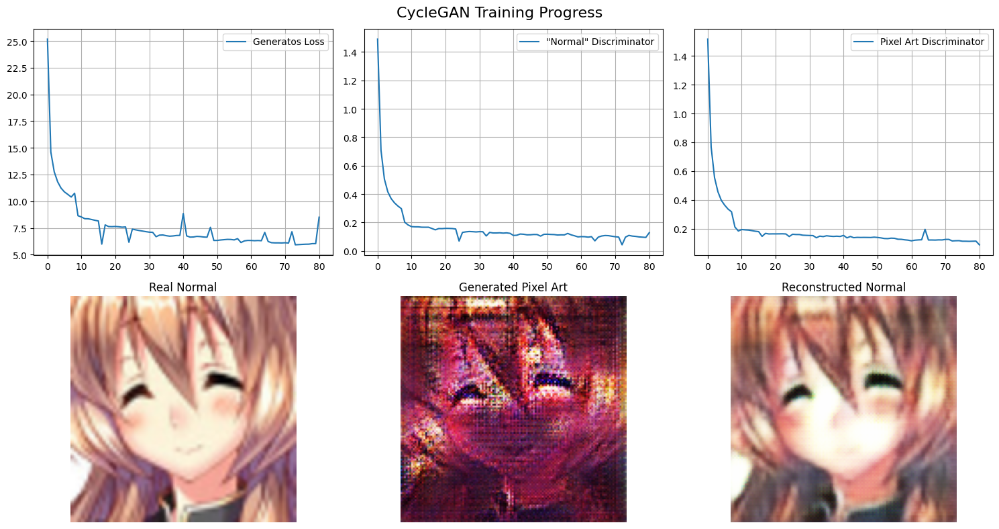

1...2...3...4...5...6...7...8...9...10...11...12...13...14...15...16...17...18...19...20...21...22...23...24...25...26...27...28...29...30...31...32...33...34...35...36...37...38...39...40...41...42...43...44...45...46...47...48...49...50...51...52...53...54...55...56...57...58...59...60...61...62...63...64...65...66...67...68...69...70...71...72...73...74...75...76...77...78...79...80...81...82...83...84...85...86...87...88...89...90...91...92...93...94...95...96...97...98...99...100...101...102...103...104...105...106...107...108...109...110...111...112...113...114...115...116...117...118...119...120...121...122...123...124...125...126...127...128...129...130...131...132...133...134...135...136...137...138...139...140...141...142...143...144...145...146...147...148...149...150...

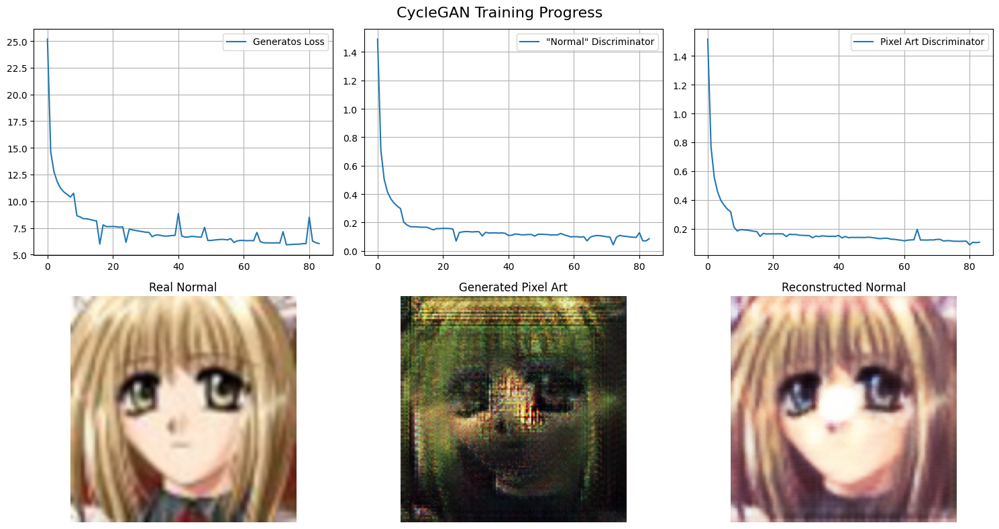

151...152...153...154...155...156...157...158...159...160...161...162...163...164...165...166...167...168...169...170...171...172...173...174...175...176...177...178...179...180...181...182...183...184...185...186...187...188...189...190...191...192...193...194...195...196...197...198...199...200...201...202...203...204...205...206...207...208...209...210...211...212...213...214...215...216...217...218...219...220...221...222...223...224...225...226...227...228...229...230...231...232...233...234...235...236...237...238...239...240...241...242...243...244...245...246...247...248...249...250...251...252...253...254...255...256...257...258...259...260...261...262...263...264...265...266...267...268...269...270...271...272...273...274...275...276...277...278...279...280...281...282...283...284...285...286...287...288...289...290...291...292...293...294...295...296...297...298...299...300...

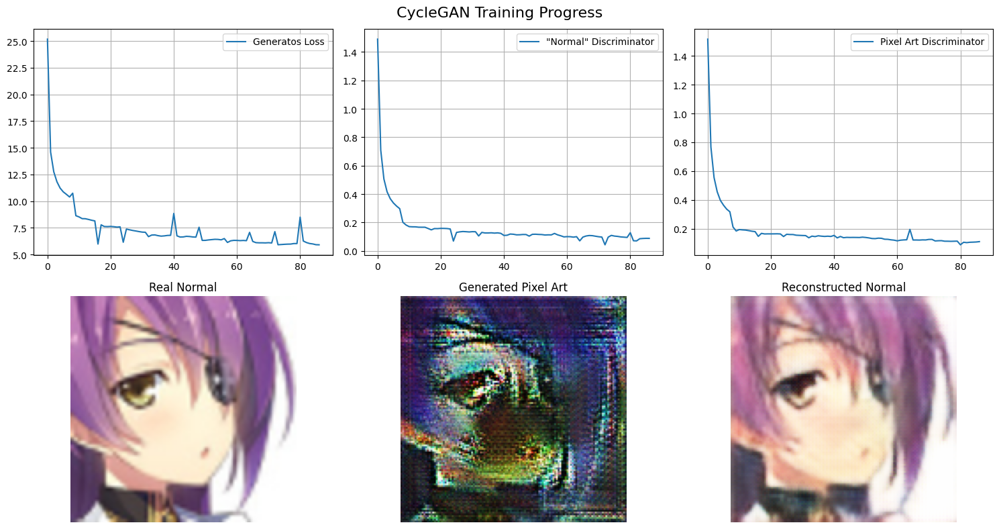

301...302...303...304...305...306...307...308...309...310...311...312...313...314...315...316...317...318...319...320...321...322...323...324...325...326...327...328...329...330...331...332...333...334...335...336...337...338...339...340...341...342...343...344...345...346...347...348...349...350...351...352...353...354...355...356...357...358...359...360...361...362...
Epoch [11/50] (363 imgs, took: 207.7s)- G: 5.9057, D_Normal: 0.0900, D_Pixel: 0.1096
0...

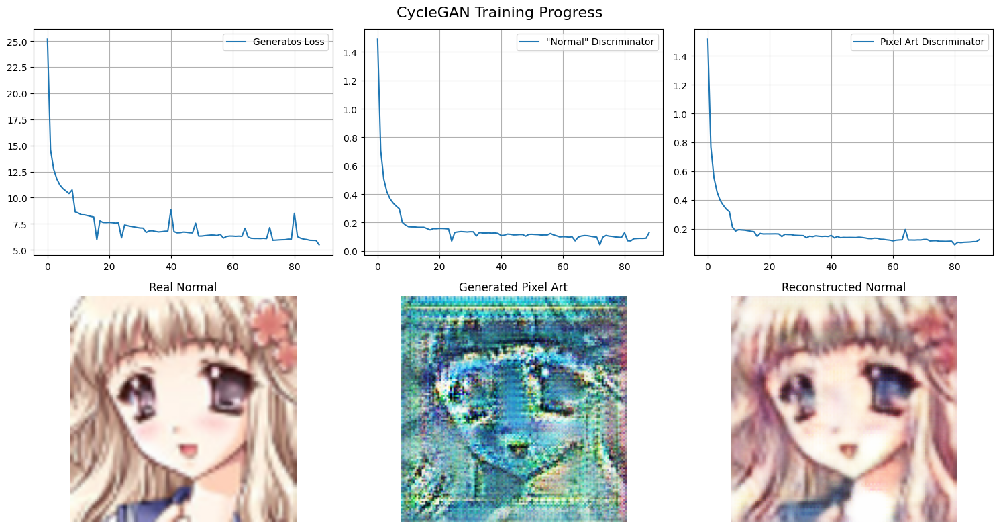

1...2...3...4...5...6...7...8...9...10...11...12...13...14...15...16...17...18...19...20...21...22...23...24...25...26...27...28...29...30...31...32...33...34...35...36...37...38...39...40...41...42...43...44...45...46...47...48...49...50...51...52...53...54...55...56...57...58...59...60...61...62...63...64...65...66...67...68...69...70...71...72...73...74...75...76...77...78...79...80...81...82...83...84...85...86...87...88...89...90...91...92...93...94...95...96...97...98...99...100...101...102...103...104...105...106...107...108...109...110...111...112...113...114...115...116...117...118...119...120...121...122...123...124...125...126...127...128...129...130...131...132...133...134...135...136...137...138...139...140...141...142...143...144...145...146...147...148...149...150...

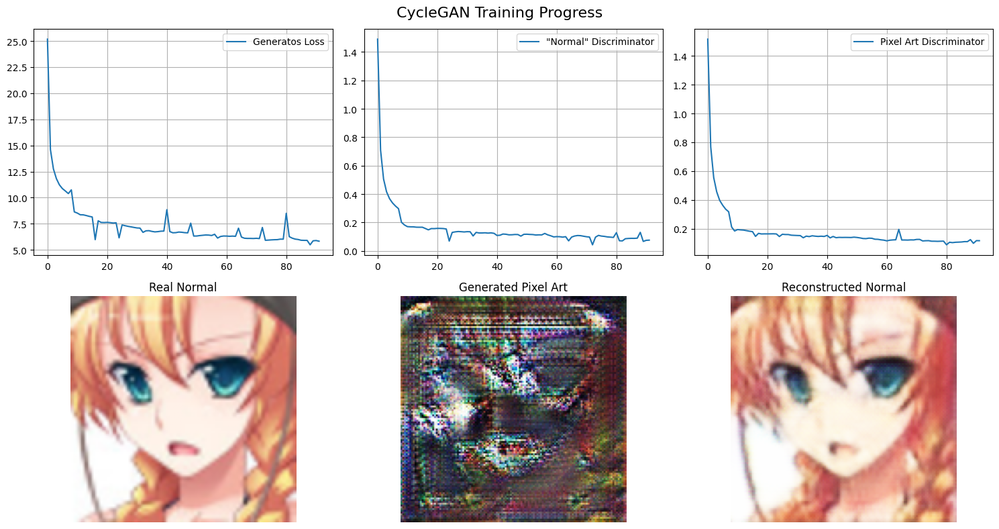

151...152...153...154...155...156...157...158...159...160...161...162...163...164...165...166...167...168...169...170...171...172...173...174...175...176...177...178...179...180...181...182...183...184...185...186...187...188...189...190...191...192...193...194...195...196...197...198...199...200...201...202...203...204...205...206...207...208...209...210...211...212...213...214...215...216...217...218...219...220...221...222...223...224...225...226...227...228...229...230...231...232...233...234...235...236...237...238...239...240...241...242...243...244...245...246...247...248...249...250...251...252...253...254...255...256...257...258...259...260...261...262...263...264...265...266...267...268...269...270...271...272...273...274...275...276...277...278...279...280...281...282...283...284...285...286...287...288...289...290...291...292...293...294...295...296...297...298...299...300...

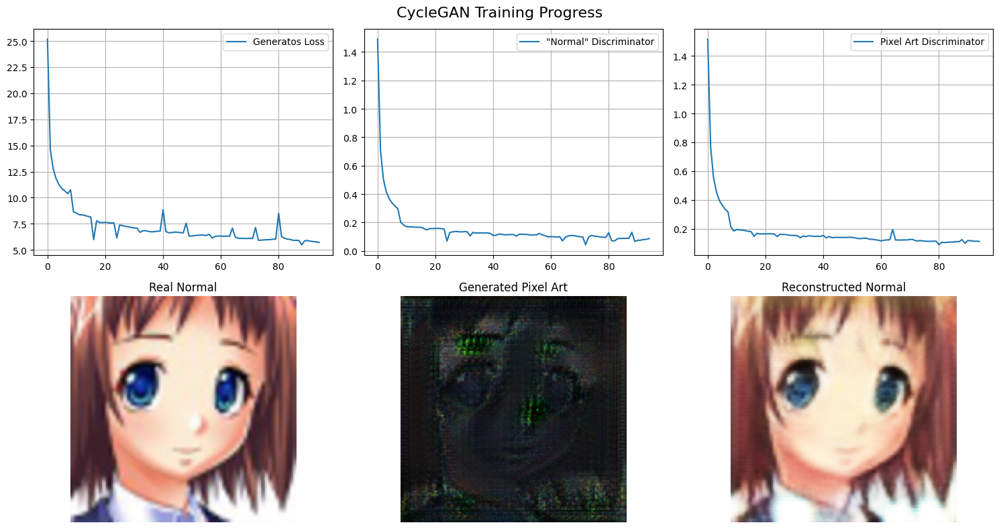

301...302...303...304...305...306...307...308...309...310...311...312...313...314...315...316...317...318...319...320...321...322...323...324...325...326...327...328...329...330...331...332...333...334...335...336...337...338...339...340...341...342...343...344...345...346...347...348...349...350...351...352...353...354...355...356...357...358...359...360...361...362...
Epoch [12/50] (363 imgs, took: 207.6s)- G: 5.7254, D_Normal: 0.0870, D_Pixel: 0.1111
0...

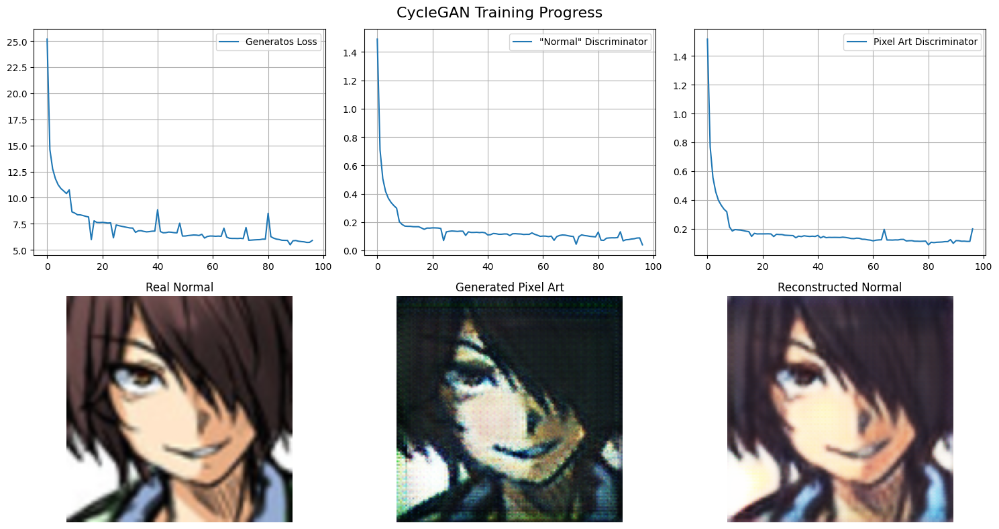

1...2...3...4...5...6...7...8...9...10...11...12...13...14...15...16...17...18...19...20...21...22...23...24...25...26...27...28...29...30...31...32...33...34...35...36...37...38...39...40...41...42...43...44...45...46...47...48...49...50...51...52...53...54...55...56...57...58...59...60...61...62...63...64...65...66...67...68...69...70...71...72...73...74...75...76...77...78...79...80...81...82...83...84...85...86...87...88...89...90...91...92...93...94...95...96...97...98...99...100...101...102...103...104...105...106...107...108...109...110...111...112...113...114...115...116...117...118...119...120...121...122...123...124...125...126...127...128...129...130...131...132...133...134...135...136...137...138...139...140...141...142...143...144...145...146...147...148...149...150...

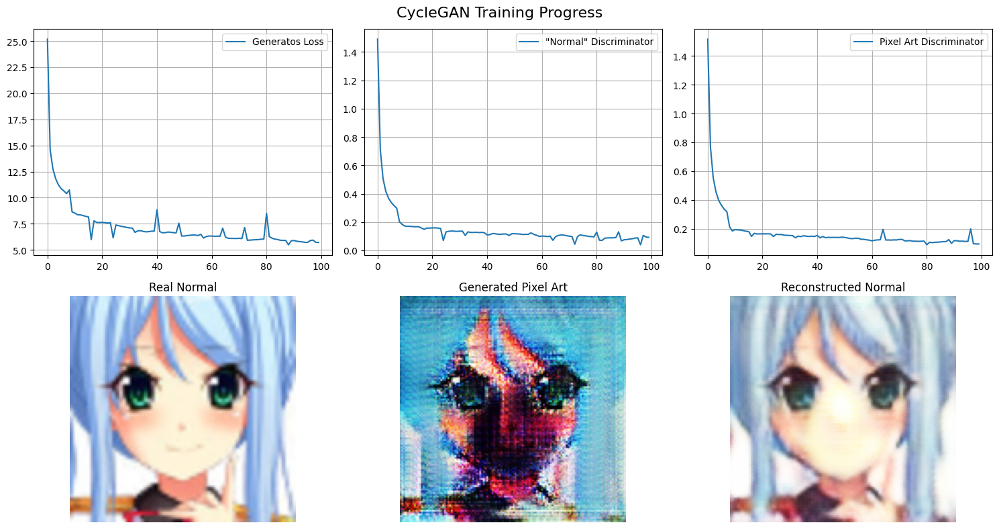

151...152...153...154...155...156...157...158...159...160...161...162...163...164...165...166...167...168...169...170...171...172...173...174...175...176...177...178...179...180...181...182...183...184...185...186...187...188...189...190...191...192...193...194...195...196...197...198...199...200...201...202...203...204...205...206...207...208...209...210...211...212...213...214...215...216...217...218...219...220...221...222...223...224...225...226...227...228...229...230...231...232...233...234...235...236...237...238...239...240...241...242...243...244...245...246...247...248...249...250...251...252...253...254...255...256...257...258...259...260...261...262...263...264...265...266...267...268...269...270...271...272...273...274...275...276...277...278...279...280...281...282...283...284...285...286...287...288...289...290...291...292...293...294...295...296...297...298...299...300...

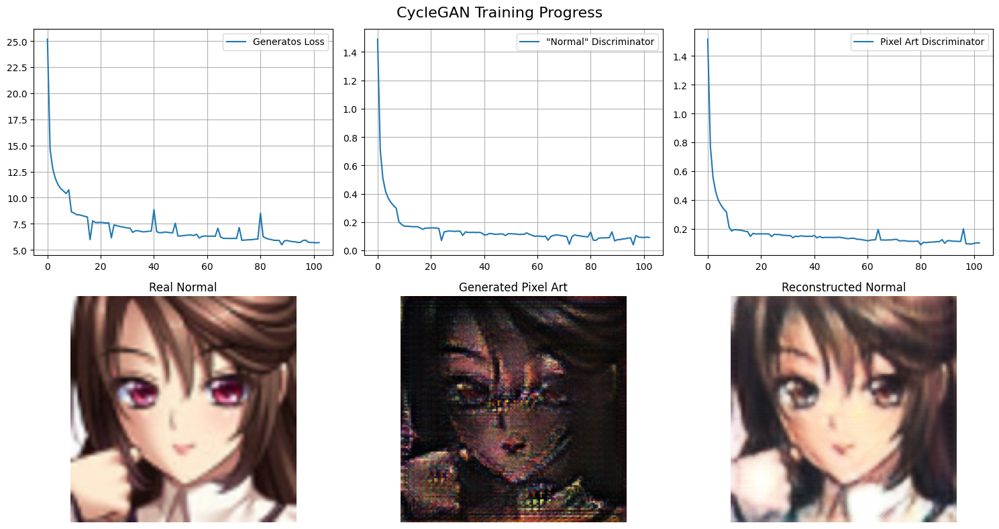

301...302...303...304...305...306...307...308...309...310...311...312...313...314...315...316...317...318...319...320...321...322...323...324...325...326...327...328...329...330...331...332...333...334...335...336...337...338...339...340...341...342...343...344...345...346...347...348...349...350...351...352...353...354...355...356...357...358...359...360...361...362...
Epoch [13/50] (363 imgs, took: 207.4s)- G: 5.6809, D_Normal: 0.0946, D_Pixel: 0.1005
0...

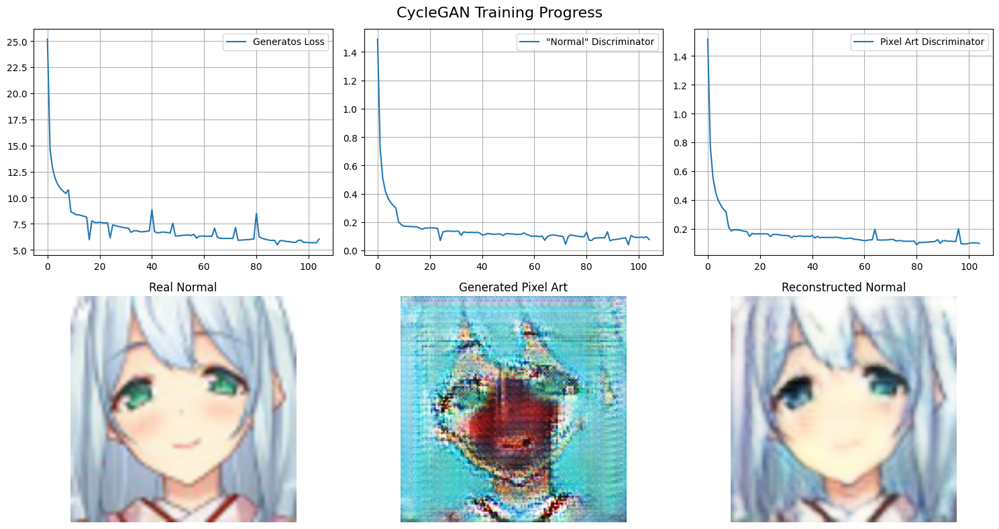

1...2...3...4...5...6...7...8...9...10...11...12...13...14...15...16...17...18...19...20...21...22...23...24...25...26...27...28...29...30...31...32...33...34...35...36...37...38...39...40...41...42...43...44...45...46...47...48...49...50...51...52...53...54...55...56...57...58...59...60...61...62...63...64...65...66...67...68...69...70...71...72...73...74...75...76...77...78...79...80...81...82...83...84...85...86...87...88...89...90...91...92...93...94...95...96...97...98...99...100...101...102...103...104...105...106...107...108...109...110...111...112...113...114...115...116...117...118...119...120...121...122...123...124...125...126...127...128...129...130...131...132...133...134...135...136...137...138...139...140...141...142...143...144...145...146...147...148...149...150...

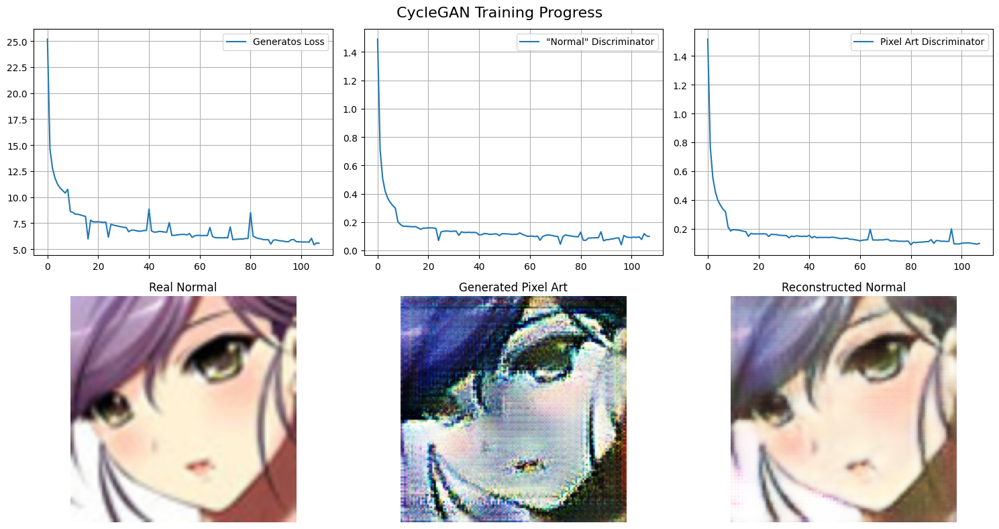

151...152...153...154...155...156...157...158...159...160...161...162...163...164...165...166...167...168...169...170...171...172...173...174...175...176...177...178...179...180...181...182...183...184...185...186...187...188...189...190...191...192...193...194...195...196...197...198...199...200...201...202...203...204...205...206...207...208...209...210...211...212...213...214...215...216...217...218...219...220...221...222...223...224...225...226...227...228...229...230...231...232...233...234...235...236...237...238...239...240...241...242...243...244...245...246...247...248...249...250...251...252...253...254...255...256...257...258...259...260...261...262...263...264...265...266...267...268...269...270...271...272...273...274...275...276...277...278...279...280...281...282...283...284...285...286...287...288...289...290...291...292...293...294...295...296...297...298...299...300...

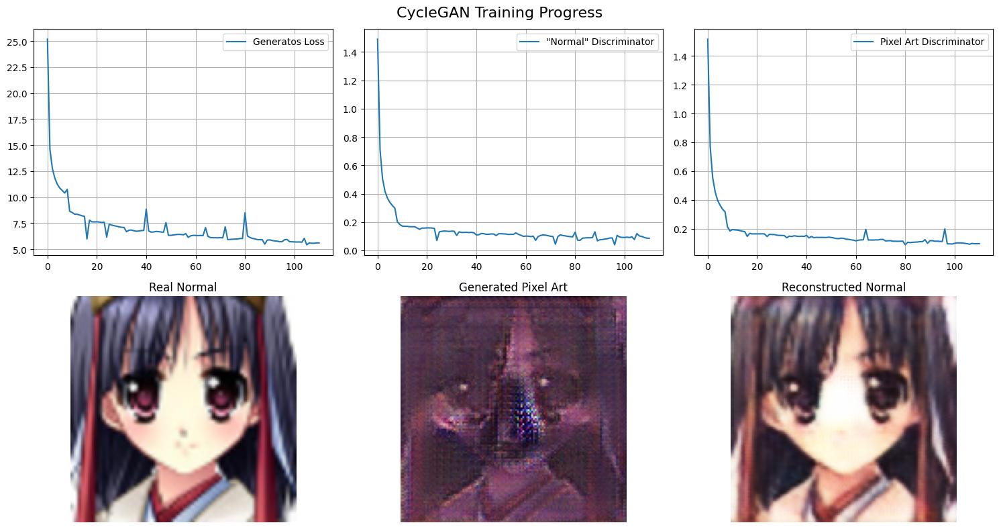

301...302...303...304...305...306...307...308...309...310...311...312...313...314...315...316...317...318...319...320...321...322...323...324...325...326...327...328...329...330...331...332...333...334...335...336...337...338...339...340...341...342...343...344...345...346...347...348...349...350...351...352...353...354...355...356...357...358...359...360...361...362...
Epoch [14/50] (363 imgs, took: 207.6s)- G: 5.5969, D_Normal: 0.0838, D_Pixel: 0.0951
0...

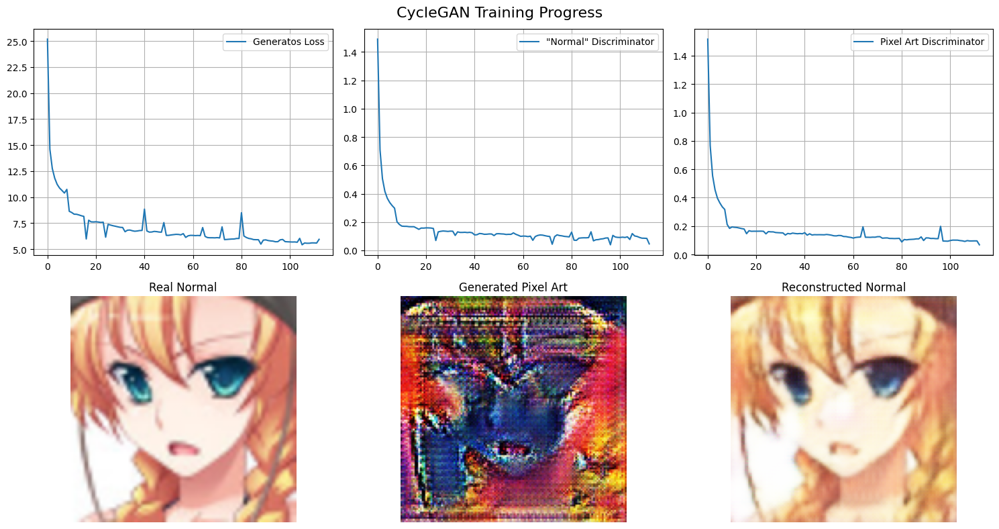

1...2...3...4...5...6...7...8...9...10...11...12...13...14...15...16...17...18...19...20...21...22...23...24...25...26...27...28...29...30...31...32...33...34...35...36...37...38...39...40...41...42...43...44...45...46...47...48...49...50...51...52...53...54...55...56...57...58...59...60...61...62...63...64...65...66...67...68...69...70...71...72...73...74...75...76...77...78...79...80...81...82...83...84...85...86...87...88...89...90...91...92...93...94...95...96...97...98...99...100...101...102...103...104...105...106...107...108...109...110...111...112...113...114...115...116...117...118...119...120...121...122...123...124...125...126...127...128...129...130...131...132...133...134...135...136...137...138...139...140...141...142...143...144...145...146...147...148...149...150...

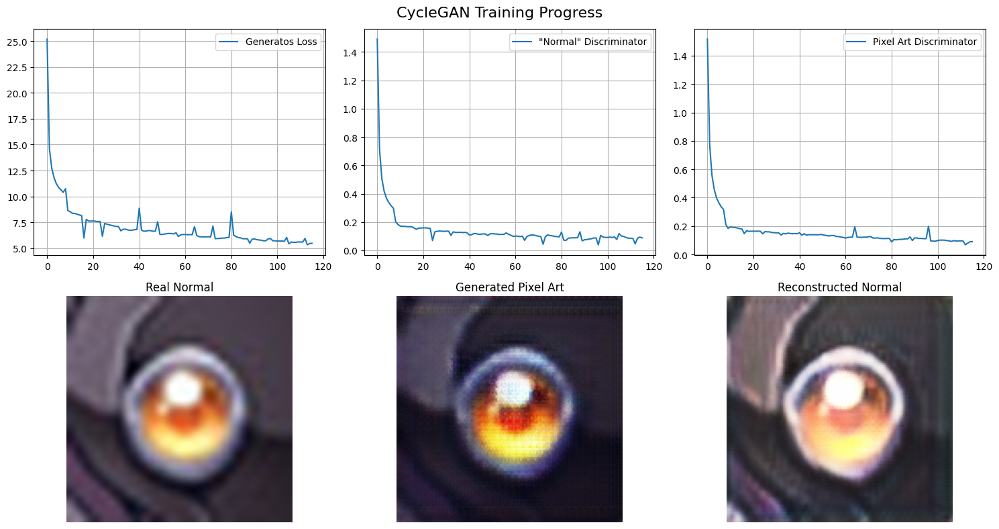

151...152...153...154...155...156...157...158...159...160...161...162...163...164...165...166...167...168...169...170...171...172...173...174...175...176...177...178...179...180...181...182...183...184...185...186...187...188...189...190...191...192...193...194...195...196...197...198...199...200...201...202...203...204...205...206...207...208...209...210...211...212...213...214...215...216...217...218...219...220...221...222...223...224...225...226...227...228...229...230...231...232...233...234...235...236...237...238...239...240...241...242...243...244...245...246...247...248...249...250...251...252...253...254...255...256...257...258...259...260...261...262...263...264...265...266...267...268...269...270...271...272...273...274...275...276...277...278...279...280...281...282...283...284...285...286...287...288...289...290...291...292...293...294...295...296...297...298...299...300...

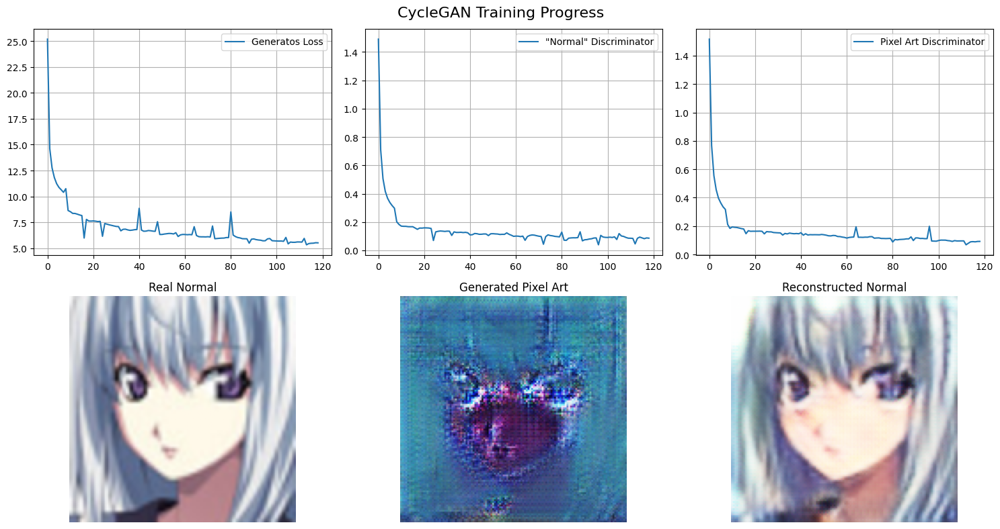

301...302...303...304...305...306...307...308...309...310...311...312...313...314...315...316...317...318...319...320...321...322...323...324...325...326...327...328...329...330...331...332...333...334...335...336...337...338...339...340...341...342...343...344...345...346...347...348...349...350...351...352...353...354...355...356...357...358...359...360...361...362...
Epoch [15/50] (363 imgs, took: 208.3s)- G: 5.5201, D_Normal: 0.0883, D_Pixel: 0.0913
Modelos guardados en drive/MyDrive/Universidad/Deep Learning/Proyecto FaceToPix/checkpoints/checkpoint_epoch_15.pth
0...

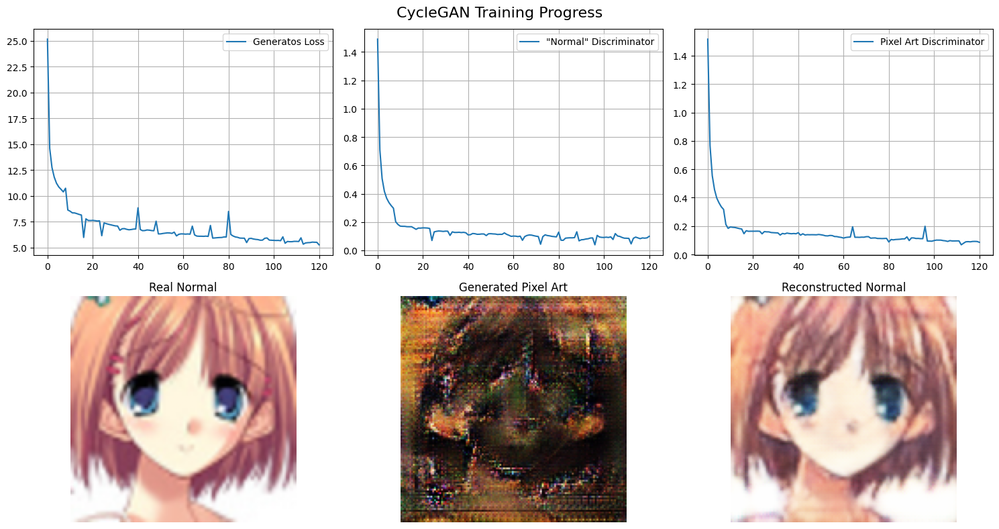

1...2...3...4...5...6...7...8...9...10...11...12...13...14...15...16...17...18...19...20...21...22...23...24...25...26...27...28...29...30...31...32...33...34...35...36...37...38...39...40...41...42...43...44...45...46...47...48...49...50...51...52...53...54...55...56...57...58...59...60...61...62...63...64...65...66...67...68...69...70...71...72...73...74...75...76...77...78...79...80...81...82...83...84...85...86...87...88...89...90...91...92...93...94...95...96...97...98...99...100...101...102...103...104...105...106...107...108...109...110...111...112...113...114...115...116...117...118...119...120...121...122...123...124...125...126...127...128...129...130...131...132...133...134...135...136...137...138...139...140...141...142...143...144...145...146...147...148...149...150...

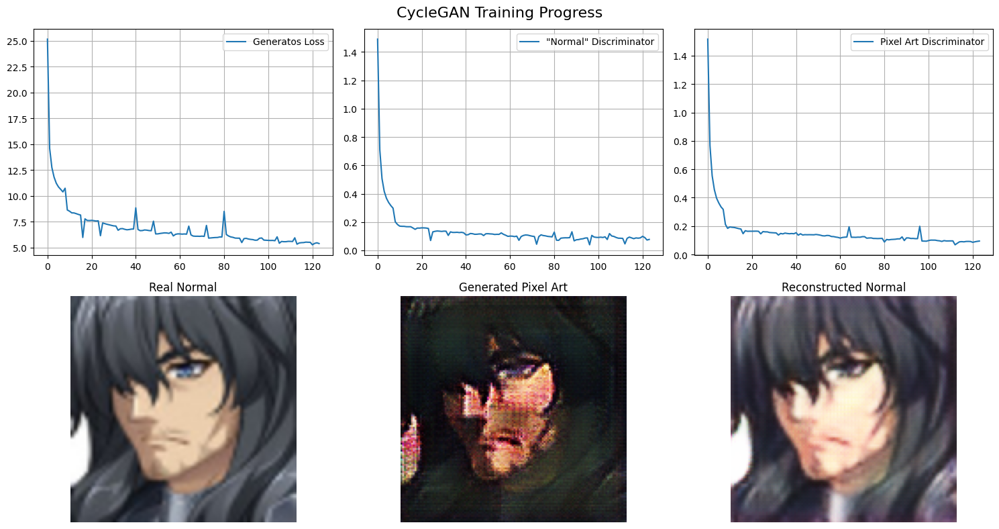

151...152...153...154...155...156...157...158...159...160...161...162...163...164...165...166...167...168...169...170...171...172...173...174...175...176...177...178...179...180...181...182...183...184...185...186...187...188...189...190...191...192...193...194...195...196...197...198...199...200...201...202...203...204...205...206...207...208...209...210...211...212...213...214...215...216...217...218...219...220...221...222...223...224...225...226...227...228...229...230...231...232...233...234...235...236...237...238...239...240...241...242...243...244...245...246...247...248...249...250...251...252...253...254...255...256...257...258...259...260...261...262...263...264...265...266...267...268...269...270...271...272...273...274...275...276...277...278...279...280...281...282...283...284...285...286...287...288...289...290...291...292...293...294...295...296...297...298...299...300...

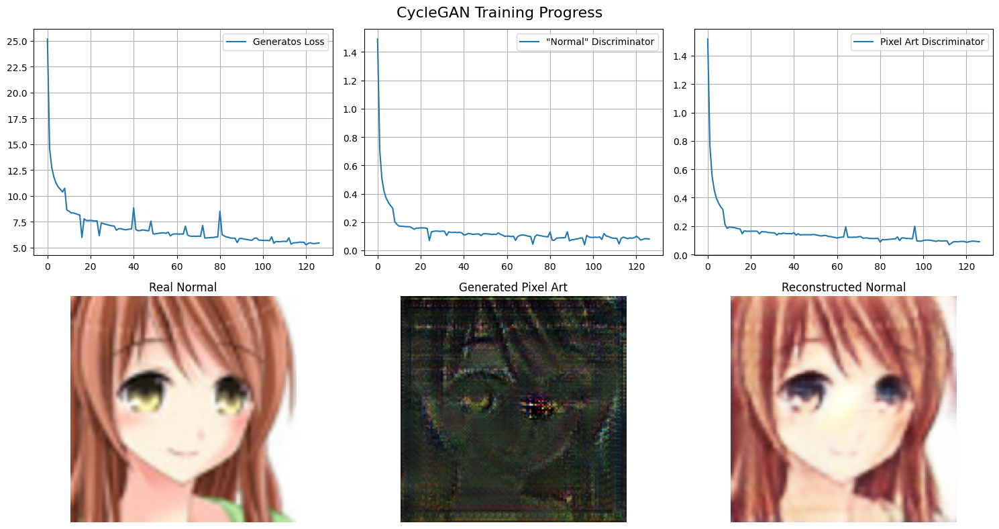

301...302...303...304...305...306...307...308...309...310...311...312...313...314...315...316...317...318...319...320...321...322...323...324...325...326...327...328...329...330...331...332...333...334...335...336...337...338...339...340...341...342...343...344...345...346...347...348...349...350...351...352...353...354...355...356...357...358...359...360...361...362...
Epoch [16/50] (363 imgs, took: 208.2s)- G: 5.4522, D_Normal: 0.0836, D_Pixel: 0.0900
0...

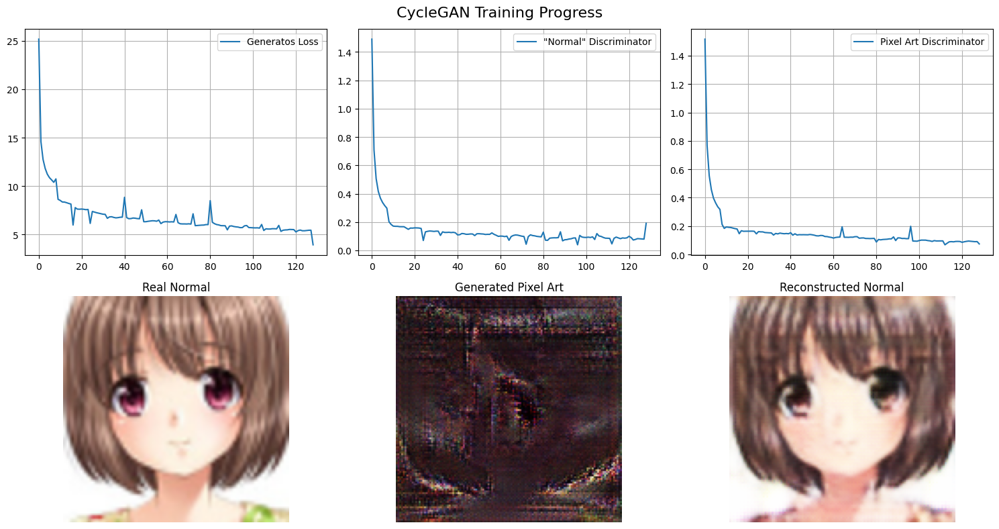

1...2...3...4...5...6...7...8...9...10...11...12...13...14...15...16...17...18...19...20...21...22...23...24...25...26...27...28...29...30...31...32...33...34...35...36...37...38...39...40...41...42...43...44...45...46...47...48...49...50...51...52...53...54...55...56...57...58...59...60...61...62...63...64...65...66...67...68...69...70...71...72...73...74...75...76...77...78...79...80...81...82...83...84...85...86...87...88...89...90...91...92...93...94...95...96...97...98...99...100...101...102...103...104...105...106...107...108...109...110...111...112...113...114...115...116...117...118...119...120...121...122...123...124...125...126...127...128...129...130...131...132...133...134...135...136...137...138...139...140...141...142...143...144...145...146...147...148...149...150...

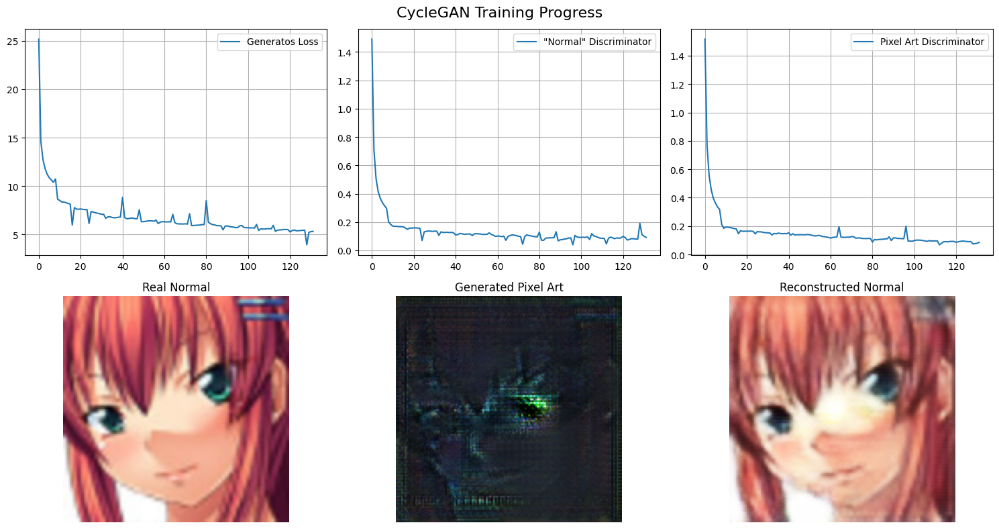

151...152...153...154...155...156...157...158...159...160...161...162...163...164...165...166...167...168...169...170...171...172...173...174...175...176...177...178...179...180...181...182...183...184...185...186...187...188...189...190...191...192...193...194...195...196...197...198...199...200...201...202...203...204...205...206...207...208...209...210...211...212...213...214...215...216...217...218...219...220...221...222...223...224...225...226...227...228...229...230...231...232...233...234...235...236...237...238...239...240...241...242...243...244...245...246...247...248...249...250...251...252...253...254...255...256...257...258...259...260...261...262...263...264...265...266...267...268...269...270...271...272...273...274...275...276...277...278...279...280...281...282...283...284...285...286...287...288...289...290...291...292...293...294...295...296...297...298...299...300...

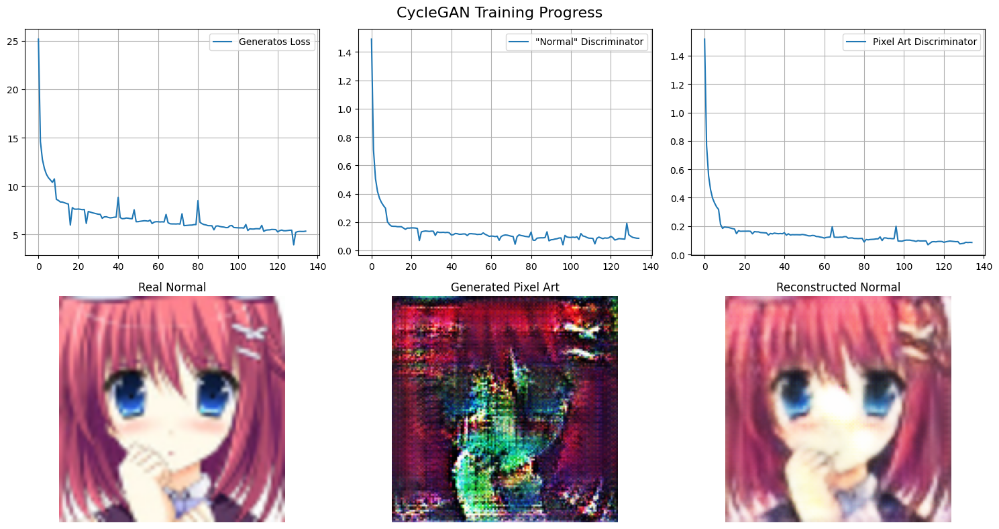

301...302...303...304...305...306...307...308...309...310...311...312...313...314...315...316...317...318...319...320...321...322...323...324...325...326...327...328...329...330...331...332...333...334...335...336...337...338...339...340...341...342...343...344...345...346...347...348...349...350...351...352...353...354...355...356...

FileNotFoundError: Caught FileNotFoundError in DataLoader worker process 1.
Original Traceback (most recent call last):
  File "/usr/local/lib/python3.12/dist-packages/torch/utils/data/_utils/worker.py", line 349, in _worker_loop
    data = fetcher.fetch(index)  # type: ignore[possibly-undefined]
           ^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/torch/utils/data/_utils/fetch.py", line 52, in fetch
    data = [self.dataset[idx] for idx in possibly_batched_index]
            ~~~~~~~~~~~~^^^^^
  File "/tmp/ipython-input-157054949.py", line 133, in __getitem__
    pixel_img = Image.open(self.files_pixel[idx % self.len_pixel]).convert("RGB")
                ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/PIL/Image.py", line 3513, in open
    fp = builtins.open(filename, "rb")
         ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
FileNotFoundError: [Errno 2] No such file or directory: 'drive/MyDrive/Universidad/Deep Learning/Proyecto FaceToPix/data/clean_pix/self-portrait-106051.png'


In [ ]:
# CycleGAN Training Class
class CycleGAN:
    def __init__(self, device="cuda" if torch.cuda.is_available() else "cpu"):
        self.device = device

        # Inicializar generadores y discriminadores
        self.G_pixel2normal = Generator().to(device)  # Blur -> Sharp
        self.G_normal2pixel = Generator().to(device)  # Sharp -> Blur
        self.D_normal = Discriminator().to(device)
        self.D_pixel = Discriminator().to(device)

        # Inicializar pesos
        self.G_pixel2normal.apply(weights_init_normal)
        self.G_normal2pixel.apply(weights_init_normal)
        self.D_normal.apply(weights_init_normal)
        self.D_pixel.apply(weights_init_normal)

        # Optimizadores
        self.optimizer_G = optim.Adam(
            itertools.chain(
                self.G_pixel2normal.parameters(), self.G_normal2pixel.parameters()
            ),
            lr=0.0002,
            betas=(0.5, 0.999),
        )
        self.optimizer_D_sharp = optim.Adam(
            self.D_normal.parameters(), lr=0.0002, betas=(0.5, 0.999)
        )
        self.optimizer_D_blur = optim.Adam(
            self.D_pixel.parameters(), lr=0.0002, betas=(0.5, 0.999)
        )

        # Pérdidas
        self.criterion_GAN = nn.MSELoss()
        self.criterion_cycle = nn.L1Loss()
        self.criterion_identity = nn.L1Loss()

        # Buffers
        self.fake_sharp_buffer = ReplayBuffer()
        self.fake_blur_buffer = ReplayBuffer()

        # Loss history
        self.history = {
            "G": [],
            "D_Normal": [],
            "D_Pixel": [],
        }

    def train_step(
        self, real_normal, real_pixel, lambda_cycle=10.0, lambda_identity=5.0
    ):
        batch_size = real_normal.size(0)
        # Calculate discriminator output size
        # with torch.no_grad():
        #     dummy_input = torch.randn(1, 3, 128, 128).to(self.device)
        #     disc_output_size = self.D(dummy_input).shape[-2:]

        # Target labels
        valid = torch.ones((real_pixel.size(0), 1, 8, 8), requires_grad=False).to(
            self.device
        )
        fake = torch.zeros((real_pixel.size(0), 1, 8, 8), requires_grad=False).to(
            self.device
        )

        # ==================== Entrenar Generadores ====================
        self.optimizer_G.zero_grad()

        # Identity loss
        loss_id_sharp = self.criterion_identity(
            self.G_pixel2normal(real_normal), real_normal
        )
        loss_id_blur = self.criterion_identity(
            self.G_normal2pixel(real_pixel), real_pixel
        )

        # GAN loss
        fake_sharp = self.G_pixel2normal(real_pixel) # Obtenemos una imagen "normal" a partir de la imagen pixelada.
        loss_GAN_blur2sharp = self.criterion_GAN(self.D_normal(fake_sharp), valid) # Validamos si la imagen "normal" falsa engaña al discriminador de normales.

        fake_blur = self.G_normal2pixel(real_normal) # Obtenemos una imagen "pixelada" a partir de la imagen normal.
        loss_GAN_sharp2blur = self.criterion_GAN(self.D_pixel(fake_blur), valid) # Validamos si la imagen "pixelada" falsa, engaña al discriminador de pixeladas.

        # Cycle loss
        recovered_blur = self.G_normal2pixel(fake_sharp)
        loss_cycle_blur = self.criterion_cycle(recovered_blur, real_pixel)

        recovered_sharp = self.G_pixel2normal(fake_blur)
        loss_cycle_sharp = self.criterion_cycle(recovered_sharp, real_normal)

        # Total loss
        loss_G = (
            loss_GAN_blur2sharp
            + loss_GAN_sharp2blur
            + 10.0 * (loss_cycle_blur + loss_cycle_sharp)
            + 5.0 * (loss_id_sharp + loss_id_blur)
        )

        loss_G.backward()
        self.optimizer_G.step()

        # ==================== Entrenar Discriminador Sharp ====================
        self.optimizer_D_sharp.zero_grad()

        loss_real = self.criterion_GAN(self.D_normal(real_normal), valid)
        fake_sharp = self.fake_sharp_buffer.push_and_pop(fake_sharp)
        loss_fake = self.criterion_GAN(self.D_normal(fake_sharp.detach()), fake)

        loss_D_sharp = (loss_real + loss_fake) / 2
        loss_D_sharp.backward()
        self.optimizer_D_sharp.step()

        # ==================== Entrenar Discriminador Blur ====================
        self.optimizer_D_blur.zero_grad()

        loss_real = self.criterion_GAN(self.D_pixel(real_pixel), valid)
        fake_blur = self.fake_blur_buffer.push_and_pop(fake_blur)
        loss_fake = self.criterion_GAN(self.D_pixel(fake_blur.detach()), fake)

        loss_D_blur = (loss_real + loss_fake) / 2
        loss_D_blur.backward()
        self.optimizer_D_blur.step()

        return {
            "G": loss_G.item(),
            "D_Normal": loss_D_sharp.item(),
            "D_Pixel": loss_D_blur.item(),
        }

    def train(self, dataloader, epochs, display_freq=10, backup_freq=5):
        # Setup visualization
        # plt.ion()
        # early_stopping = EarlyStopping(patience=10, verbose=True)

        for epoch in range(epochs):
            epoch_losses = {
                "G": [],
                "D_Normal": [],
                "D_Pixel": [],
            }
            start = time.time()

            for i, batch in enumerate(dataloader):
                print(f"{i}...", end="")
                real_normal = batch["normal"].to(self.device)
                real_pixel = batch["pixel"].to(self.device)

                losses = self.train_step(real_normal, real_pixel)

                for k, v in losses.items():
                    epoch_losses[k].append(v)

                if i % 50 == 0:
                    # Update loss plots
                    for k in [
                        "G",
                        "D_Normal",
                        "D_Pixel",
                    ]:
                        # print(f"{i} - Passing: {k}")
                        # print(f"Type: {type(epoch_losses[k])}")
                        self.history[k].append(np.mean(epoch_losses[k]))

                # Update visualization
                if i % display_freq == 0:
                    fig, axes = plt.subplots(2, 3, figsize=(15, 8))
                    fig.suptitle("CycleGAN Training Progress", fontsize=16)

                    # Loss plots
                    ax_n2p = axes[0, 0]
                    ax_p2n = axes[0, 1]
                    ax_disc = axes[0, 2]

                    # Image display
                    ax_real = axes[1, 0]
                    ax_fake = axes[1, 1]
                    ax_recon = axes[1, 2]

                    ax_n2p.set_title("Normal to Pixel Loss")
                    ax_p2n.set_title("Pixel to Normal Loss")
                    ax_disc.set_title("Discriminator Loss")
                    ax_real.set_title("Real Normal")
                    ax_fake.set_title("Generated Pixel Art")
                    ax_recon.set_title("Reconstructed Normal")

                    for ax in [ax_real, ax_fake, ax_recon]:
                        ax.axis("off")

                    ax_n2p.clear()
                    ax_n2p.plot(self.history["G"], label="Generatos Loss")
                    ax_n2p.legend()
                    ax_n2p.grid(True)

                    ax_p2n.clear()
                    ax_p2n.plot(self.history["D_Normal"], label="\"Normal\" Discriminator")
                    ax_p2n.legend()
                    ax_p2n.grid(True)

                    ax_disc.clear()
                    ax_disc.plot(self.history["D_Pixel"], label="Pixel Art Discriminator")
                    ax_disc.legend()
                    ax_disc.grid(True)

                    # Update images
                    with torch.no_grad():
                        fake_pixel = self.G_normal2pixel(real_normal[:1])
                        recon_normal = self.G_pixel2normal(fake_pixel)

                    def tensor_to_image(tensor):
                        img = tensor.cpu().squeeze().permute(1, 2, 0).numpy()
                        img = (img + 1) / 2  # Denormalize from [-1, 1] to [0, 1]
                        return np.clip(img, 0, 1)

                    ax_real.clear()
                    ax_real.imshow(tensor_to_image(real_normal[0]))
                    ax_real.set_title("Real Normal")
                    ax_real.axis("off")

                    ax_fake.clear()
                    ax_fake.imshow(tensor_to_image(fake_pixel[0]))
                    ax_fake.set_title("Generated Pixel Art")
                    ax_fake.axis("off")

                    ax_recon.clear()
                    ax_recon.imshow(tensor_to_image(recon_normal[0]))
                    ax_recon.set_title("Reconstructed Normal")
                    ax_recon.axis("off")

                    plt.tight_layout()
                    plt.pause(0.01)

            print(
                f"\nEpoch [{epoch + 1}/{epochs}] ({len(dataloader)} imgs, took: {(time.time() - start):.1f}s)"
                f"- G: {np.mean(epoch_losses['G']):.4f}, "
                f"D_Normal: {np.mean(epoch_losses['D_Normal']):.4f}, "
                f"D_Pixel: {np.mean(epoch_losses['D_Pixel']):.4f}"
            )
            if (epoch + 1) % backup_freq == 0:
                path = f"{BASE_PATH}/checkpoints/checkpoint_epoch_{epoch + 1}.pth"
                self.save_models(path)

        # plt.ioff()
        plt.show()

    def save_models(self, path):
        torch.save(
            {
                "G_pixel2normal": self.G_pixel2normal.state_dict(),
                "G_normal2pixel": self.G_normal2pixel.state_dict(),
                "D_normal": self.D_normal.state_dict(),
                "D_pixel": self.D_pixel.state_dict(),
            },
            path,
        )
        print(f"Modelos guardados en {path}")

    def load_models(self, path):
        checkpoint = torch.load(path)
        self.G_pixel2normal.load_state_dict(checkpoint["G_pixel2normal"])
        self.G_normal2pixel.load_state_dict(checkpoint["G_normal2pixel"])
        self.D_normal.load_state_dict(checkpoint["D_normal"])
        self.D_pixel.load_state_dict(checkpoint["D_pixel"])
        print(f"Modelos cargados desde {path}")


# Main execution
# Transform for 128x128 images
sharp_transform = transforms.Compose(
    [
        transforms.Resize((128, 128)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5]),
    ]
)
pixel_transform = transforms.Compose(
    [
        transforms.Resize(
            size=(128, 128), interpolation=transforms.InterpolationMode.NEAREST
        ),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5]),
    ]
)

# Example usage (adjust paths to your dataset)
dataset = ImageDataset(
    root_normal=SHARP_PATH,
    root_pixel=PIXEL_PATH,
    sharp_transform=sharp_transform,
    pixel_transform=pixel_transform,
)
dataloader = DataLoader(dataset, batch_size=4, shuffle=True, num_workers=2)

cyclegan = CycleGAN()
cyclegan.train(dataloader, epochs=50, display_freq=150, backup_freq=5)

In [ ]:
img = Image.open(f"{BASE_PATH}/data/del.jpg").convert('RGB')
img_tensor = sharp_transform(img).unsqueeze(0).to("cuda")
with torch.no_grad():
            output = cyclegan.D_pixel(img_tensor)
print("Is del.jpg a pixel?", output)

img = Image.open(f"{BASE_PATH}/data/del.jpg").convert('RGB')
img_tensor = sharp_transform(img).unsqueeze(0).to("cuda")
with torch.no_grad():
            output = cyclegan.D_normal(img_tensor)
print("Is del.jpg normal?", output)


In [ ]:
# cyclegan.load_models(f"{BASE_PATH}/checkpoints/checkpoint_epoch_50.pth")

# img = Image.open(f"{BASE_PATH}/data/del.jpg").convert('RGB')
# img_tensor = sharp_transform(img).unsqueeze(0).to("cuda")
# with torch.no_grad():
#             output = cyclegan.G_normal2pixel(img_tensor)
# output = output.squeeze(0).cpu()
# output = output * 0.5 + 0.5
# output = transforms.ToPILImage()(output)
# output.save(f"{BASE_PATH}/data/del_pix.png")

def tensor_to_image(tensor):
      img = tensor.cpu().squeeze().permute(1, 2, 0).numpy()
      img = (img + 1) / 2  # Denormalize from [-1, 1] to [0, 1]
      return np.clip(img, 0, 1)

def toPixelArt(title: str, imagePath: str):
  img = Image.open(imagePath).convert('RGB')
  real_normal = sharp_transform(img).unsqueeze(0).to("cuda")

  fig, axes = plt.subplots(1, 3, figsize=(30, 20))
  fig.suptitle(title, fontsize=16)

  ax_original = axes[0]
  ax_pixelated = axes[ 1]
  ax_recon = axes[2]

  # Update images
  with torch.no_grad():
      fake_pixel = cyclegan.G_normal2pixel(real_normal)
      recon_normal = cyclegan.G_pixel2normal(fake_pixel)

  ax_original.clear()
  ax_original.imshow(tensor_to_image(real_normal[0]))
  ax_original.set_title("Original")
  ax_original.axis("off")

  ax_pixelated.clear()
  ax_pixelated.imshow(tensor_to_image(fake_pixel[0]))
  ax_pixelated.set_title("Generated Pixel Art")
  ax_pixelated.axis("off")

  ax_recon.clear()
  ax_recon.imshow(tensor_to_image(recon_normal[0]))
  ax_recon.set_title("Recon image")
  ax_recon.axis("off")

  fig.show()

images = [os.path.join(BASE_PATH, "data/examples", f) for f in os.listdir(f"{BASE_PATH}/data/examples")]
print(images)
#images = images[:4]
epochs = [ i for i in range(5, 10, 5)]

fig, axes = plt.subplots(len(epochs)+1, len(images), figsize=(15, 25))
fig.suptitle("Examples", fontsize=16)

for i, imagePath in enumerate(images):
  img = Image.open(imagePath).convert('RGB')
  real_normal = sharp_transform(img).unsqueeze(0).to("cuda")

  ax_example = axes[0, i]
  ax_example.clear()
  ax_example.imshow(tensor_to_image(real_normal[0]))
  # ax_example.set_title("Original")
  ax_example.axis("off")

for i, epoch in enumerate(epochs):
  cyclegan.load_models(f"{BASE_PATH}/checkpoints/checkpoint_epoch_{epoch}.pth")
  for j, imagePath in enumerate(images):
    img = Image.open(imagePath).convert('RGB')
    real_normal = sharp_transform(img).unsqueeze(0).to("cuda")
    with torch.no_grad():
        fake_pixel = cyclegan.G_normal2pixel(real_normal)
    ax_example = axes[i+1, j]
    ax_example.clear()
    ax_example.imshow(tensor_to_image(fake_pixel[0]))
    # ax_example.set_title("Original")
    ax_example.axis("off")

fig.tight_layout()
fig.show()


In [ ]:
#!/usr/bin/env python3
import os
from PIL import Image
from collections import Counter
import numpy as np
import subprocess


def analyze_image_folder(folder_path):
    """
    Performs exploratory data analysis on images in a folder.

    Args:
        folder_path (str): Path to the folder containing images
    """
    # Supported image extensions
    img_exts = {".jpg", ".jpeg", ".png", ".gif", ".bmp", ".tiff", ".webp"}

    # Initialize tracking variables
    img_files = []
    dimensions = []
    formats = []
    modes = []
    file_sizes = []
    aspect_ratios = []
    has_transparency = []

    # Scan folder
    print(f"📁 Analyzing folder: {folder_path}\n")
    print("=" * 70)

    copy_paths = []
    for file in os.listdir(folder_path):
        file_path = os.path.join(folder_path, file)
        if os.path.isfile(file_path) and os.path.splitext(file)[1].lower() in img_exts:
            try:
                with Image.open(file_path) as img:
                    img_files.append(file)
                    dimensions.append(img.size)
                    formats.append(img.format)
                    modes.append(img.mode)
                    aspect_ratios.append(img.size[0] / img.size[1])
                    file_sizes.append(os.path.getsize(file_path))

                    # Check for transparency
                    transparency = False
                    if img.mode == "RGBA":
                        # Check if any alpha channel pixel is not fully opaque
                        alpha = np.array(img.getchannel("A"))
                        transparency = np.any(alpha < 255)
                    elif img.mode == "LA":
                        # Grayscale with alpha
                        alpha = np.array(img.getchannel("A"))
                        transparency = np.any(alpha < 255)
                    elif img.mode == "P" and "transparency" in img.info:
                        # Palette mode with transparency
                        transparency = True

                    if (
                        img.size[0] == 128
                        and img.size[0] == img.size[1]
                        and not transparency
                    ):
                        copy_paths.append(file_path)

                    has_transparency.append(transparency)
            except Exception as e:
                print(f"⚠️  Could not read {file}: {e}")

    if not img_files:
        print("❌ No valid images found in the folder!")
        return

    # for path in copy_paths:
    #     filename = os.path.basename(path)
    #     subprocess.run(["cp", path, os.path.join(BASE_PATH, "data/clean_pix", filename)])

    # Basic statistics
    print(f"\n📊 BASIC STATISTICS")
    print("-" * 70)
    print(f"Total images found: {len(img_files)}")
    print(f"Total size on disk: {sum(file_sizes) / (1024 * 1024):.2f} MB")
    print(f"Average file size: {np.mean(file_sizes) / 1024:.2f} KB")

    # Dimensions analysis
    print(f"\n📐 DIMENSIONS ANALYSIS")
    print("-" * 70)
    widths = [d[0] for d in dimensions]
    heights = [d[1] for d in dimensions]

    print(
        f"Width  - Min: {min(widths):,}px | Max: {max(widths):,}px | Avg: {np.mean(widths):.0f}px"
    )
    print(
        f"Height - Min: {min(heights):,}px | Max: {max(heights):,}px | Avg: {np.mean(heights):.0f}px"
    )

    # Most common dimensions
    dim_counts = Counter(dimensions)
    print(f"\nMost common dimensions:")
    for dim, count in dim_counts.most_common(5):
        print(
            f"  {dim[0]}x{dim[1]} - {count} images ({count / len(img_files) * 100:.1f}%)"
        )

    # Aspect ratios
    print(f"\n📏 ASPECT RATIO ANALYSIS")
    print("-" * 70)
    print(f"Average aspect ratio: {np.mean(aspect_ratios):.2f}")
    print(f"Aspect ratio range: {min(aspect_ratios):.2f} to {max(aspect_ratios):.2f}")

    # Classify aspect ratios
    landscape = sum(1 for ar in aspect_ratios if ar > 1.1)
    portrait = sum(1 for ar in aspect_ratios if ar < 0.9)
    square = len(aspect_ratios) - landscape - portrait

    print(f"\nOrientation distribution:")
    print(f"  Landscape: {landscape} ({landscape / len(img_files) * 100:.1f}%)")
    print(f"  Portrait:  {portrait} ({portrait / len(img_files) * 100:.1f}%)")
    print(f"  Square:    {square} ({square / len(img_files) * 100:.1f}%)")

    # Format analysis
    print(f"\n🖼️  FORMAT ANALYSIS")
    print("-" * 70)
    format_counts = Counter(formats)
    for fmt, count in format_counts.most_common():
        print(f"  {fmt}: {count} images ({count / len(img_files) * 100:.1f}%)")

    # Color mode analysis
    print(f"\n🎨 COLOR MODE ANALYSIS")
    print("-" * 70)
    mode_counts = Counter(modes)
    mode_descriptions = {
        "RGB": "RGB (Color)",
        "RGBA": "RGBA (Color with transparency)",
        "L": "Grayscale",
        "P": "Palette mode",
        "CMYK": "CMYK (Print color)",
    }
    for mode, count in mode_counts.most_common():
        desc = mode_descriptions.get(mode, mode)
        print(f"  {desc}: {count} images ({count / len(img_files) * 100:.1f}%)")

    # Resolution analysis
    print(f"\n🔍 RESOLUTION ANALYSIS")
    print("-" * 70)
    megapixels = [(w * h) / 1_000_000 for w, h in dimensions]
    print(
        f"Megapixels - Min: {min(megapixels):.2f}MP | Max: {max(megapixels):.2f}MP | Avg: {np.mean(megapixels):.2f}MP"
    )

    # Classify by resolution
    low_res = sum(1 for mp in megapixels if mp < 1)
    med_res = sum(1 for mp in megapixels if 1 <= mp < 5)
    high_res = sum(1 for mp in megapixels if mp >= 5)

    print(f"\nResolution categories:")
    print(f"  Low (<1MP):    {low_res} images ({low_res / len(img_files) * 100:.1f}%)")
    print(f"  Medium (1-5MP): {med_res} images ({med_res / len(img_files) * 100:.1f}%)")
    print(
        f"  High (>5MP):    {high_res} images ({high_res / len(img_files) * 100:.1f}%)"
    )

    # Transparency analysis
    print(f"\n🔳 TRANSPARENCY ANALYSIS")
    print("-" * 70)
    with_transparency = sum(has_transparency)
    without_transparency = len(has_transparency) - with_transparency
    print(
        f"Images with transparency: {with_transparency} ({with_transparency / len(img_files) * 100:.1f}%)"
    )
    print(
        f"Images without transparency: {without_transparency} ({without_transparency / len(img_files) * 100:.1f}%)"
    )

    # Images without transparency by size
    print(f"\n📦 IMAGES WITHOUT TRANSPARENCY BY SIZE")
    print("-" * 70)

    # Group images without transparency by dimensions
    top_n = 5
    no_trans_by_size = {}
    for i, (dim, has_trans) in enumerate(zip(dimensions, has_transparency)):
        if not has_trans and dim[0] == dim[1]:
            dim_key = f"{dim[0]}x{dim[1]}"
            if dim_key not in no_trans_by_size:
                no_trans_by_size[dim_key] = 0
            no_trans_by_size[dim_key] += 1

    # Sort by dimension size (width * height) and print
    if no_trans_by_size:
        sorted_sizes = sorted(
            no_trans_by_size.items(),
            # key=lambda x: int(x[0].split("x")[0]) * int(x[0].split("x")[1]),
            key=lambda x: x[1],
            reverse=True,
        )

        for dim_str, count in sorted_sizes[:top_n]:
            width, height = map(int, dim_str.split("x"))
            total_of_size = sum(1 for dim in dimensions if dim == (width, height))
            percentage = (count / total_of_size * 100) if total_of_size > 0 else 0
            print(
                f"  {dim_str:15} - {count:4} images without transparency (out of {total_of_size} total, {percentage:.1f}%)"
            )
    else:
        print("  No images without transparency found.")

    print("\n" + "=" * 70)
    print("✅ Analysis complete!\n")


# Example usage:
# analyze_image_folder(os.path.join(BASE_PATH, "Pixie"))
analyze_image_folder(os.path.join(BASE_PATH, "data/clean_pix"))

## Heat Maps

In [16]:
# CycleGAN Training Class
class CycleGAN:
    def __init__(self, device="cuda" if torch.cuda.is_available() else "cpu"):
        self.device = device

        # Inicializar generadores y discriminadores
        self.G_pixel2normal = Generator().to(device)  # Blur -> Sharp
        self.G_normal2pixel = Generator().to(device)  # Sharp -> Blur
        self.D_normal = Discriminator().to(device)
        self.D_pixel = Discriminator().to(device)

        # Inicializar pesos
        self.G_pixel2normal.apply(weights_init_normal)
        self.G_normal2pixel.apply(weights_init_normal)
        self.D_normal.apply(weights_init_normal)
        self.D_pixel.apply(weights_init_normal)

        # Optimizadores
        self.optimizer_G = optim.Adam(
            itertools.chain(
                self.G_pixel2normal.parameters(), self.G_normal2pixel.parameters()
            ),
            lr=0.0002,
            betas=(0.5, 0.999),
        )
        self.optimizer_D_sharp = optim.Adam(
            self.D_normal.parameters(), lr=0.0002, betas=(0.5, 0.999)
        )
        self.optimizer_D_blur = optim.Adam(
            self.D_pixel.parameters(), lr=0.0002, betas=(0.5, 0.999)
        )

        # Pérdidas
        self.criterion_GAN = nn.MSELoss()
        self.criterion_cycle = nn.L1Loss()
        self.criterion_identity = nn.L1Loss()

        # Buffers
        self.fake_sharp_buffer = ReplayBuffer()
        self.fake_blur_buffer = ReplayBuffer()

        # Loss history
        self.history = {
            "G": [],
            "D_Normal": [],
            "D_Pixel": [],
        }

    def train_step(
        self, real_normal, real_pixel, lambda_cycle=10.0, lambda_identity=5.0
    ):
        batch_size = real_normal.size(0)
        # Calculate discriminator output size
        # with torch.no_grad():
        #     dummy_input = torch.randn(1, 3, 128, 128).to(self.device)
        #     disc_output_size = self.D(dummy_input).shape[-2:]

        # Target labels
        valid = torch.ones((real_pixel.size(0), 1, 8, 8), requires_grad=False).to(
            self.device
        )
        fake = torch.zeros((real_pixel.size(0), 1, 8, 8), requires_grad=False).to(
            self.device
        )

        # ==================== Entrenar Generadores ====================
        self.optimizer_G.zero_grad()

        # Identity loss
        loss_id_sharp = self.criterion_identity(
            self.G_pixel2normal(real_normal), real_normal
        )
        loss_id_blur = self.criterion_identity(
            self.G_normal2pixel(real_pixel), real_pixel
        )

        # GAN loss
        fake_sharp = self.G_pixel2normal(real_pixel) # Obtenemos una imagen "normal" a partir de la imagen pixelada.
        loss_GAN_blur2sharp = self.criterion_GAN(self.D_normal(fake_sharp), valid) # Validamos si la imagen "normal" falsa engaña al discriminador de normales.

        fake_blur = self.G_normal2pixel(real_normal) # Obtenemos una imagen "pixelada" a partir de la imagen normal.
        loss_GAN_sharp2blur = self.criterion_GAN(self.D_pixel(fake_blur), valid) # Validamos si la imagen "pixelada" falsa, engaña al discriminador de pixeladas.

        # Cycle loss
        recovered_blur = self.G_normal2pixel(fake_sharp)
        loss_cycle_blur = self.criterion_cycle(recovered_blur, real_pixel)

        recovered_sharp = self.G_pixel2normal(fake_blur)
        loss_cycle_sharp = self.criterion_cycle(recovered_sharp, real_normal)

        # Total loss
        loss_G = (
            loss_GAN_blur2sharp
            + loss_GAN_sharp2blur
            + 10.0 * (loss_cycle_blur + loss_cycle_sharp)
            + 5.0 * (loss_id_sharp + loss_id_blur)
        )

        loss_G.backward()
        self.optimizer_G.step()

        # ==================== Entrenar Discriminador Sharp ====================
        self.optimizer_D_sharp.zero_grad()

        loss_real = self.criterion_GAN(self.D_normal(real_normal), valid)
        fake_sharp = self.fake_sharp_buffer.push_and_pop(fake_sharp)
        loss_fake = self.criterion_GAN(self.D_normal(fake_sharp.detach()), fake)

        loss_D_sharp = (loss_real + loss_fake) / 2
        loss_D_sharp.backward()
        self.optimizer_D_sharp.step()

        # ==================== Entrenar Discriminador Blur ====================
        self.optimizer_D_blur.zero_grad()

        loss_real = self.criterion_GAN(self.D_pixel(real_pixel), valid)
        fake_blur = self.fake_blur_buffer.push_and_pop(fake_blur)
        loss_fake = self.criterion_GAN(self.D_pixel(fake_blur.detach()), fake)

        loss_D_blur = (loss_real + loss_fake) / 2
        loss_D_blur.backward()
        self.optimizer_D_blur.step()

        return {
            "G": loss_G.item(),
            "D_Normal": loss_D_sharp.item(),
            "D_Pixel": loss_D_blur.item(),
        }

    def train(self, dataloader, epochs, display_freq=10, backup_freq=5):
        # Setup visualization
        # plt.ion()
        # early_stopping = EarlyStopping(patience=10, verbose=True)

        for epoch in range(epochs):
            epoch_losses = {
                "G": [],
                "D_Normal": [],
                "D_Pixel": [],
            }
            start = time.time()

            for i, batch in enumerate(dataloader):
                print(f"{i}...", end="")
                real_normal = batch["normal"].to(self.device)
                real_pixel = batch["pixel"].to(self.device)

                losses = self.train_step(real_normal, real_pixel)

                for k, v in losses.items():
                    epoch_losses[k].append(v)

                if i % 50 == 0:
                    # Update loss plots
                    for k in [
                        "G",
                        "D_Normal",
                        "D_Pixel",
                    ]:
                        # print(f"{i} - Passing: {k}")
                        # print(f"Type: {type(epoch_losses[k])}")
                        self.history[k].append(np.mean(epoch_losses[k]))

                # Update visualization
                if i % display_freq == 0:
                    fig, axes = plt.subplots(2, 3, figsize=(15, 8))
                    fig.suptitle("CycleGAN Training Progress", fontsize=16)

                    # Loss plots
                    ax_n2p = axes[0, 0]
                    ax_p2n = axes[0, 1]
                    ax_disc = axes[0, 2]

                    # Image display
                    ax_real = axes[1, 0]
                    ax_fake = axes[1, 1]
                    ax_recon = axes[1, 2]

                    ax_n2p.set_title("Normal to Pixel Loss")
                    ax_p2n.set_title("Pixel to Normal Loss")
                    ax_disc.set_title("Discriminator Loss")
                    ax_real.set_title("Real Normal")
                    ax_fake.set_title("Generated Pixel Art")
                    ax_recon.set_title("Reconstructed Normal")

                    for ax in [ax_real, ax_fake, ax_recon]:
                        ax.axis("off")

                    ax_n2p.clear()
                    ax_n2p.plot(self.history["G"], label="Generatos Loss")
                    ax_n2p.legend()
                    ax_n2p.grid(True)

                    ax_p2n.clear()
                    ax_p2n.plot(self.history["D_Normal"], label="\"Normal\" Discriminator")
                    ax_p2n.legend()
                    ax_p2n.grid(True)

                    ax_disc.clear()
                    ax_disc.plot(self.history["D_Pixel"], label="Pixel Art Discriminator")
                    ax_disc.legend()
                    ax_disc.grid(True)

                    # Update images
                    with torch.no_grad():
                        fake_pixel = self.G_normal2pixel(real_normal[:1])
                        recon_normal = self.G_pixel2normal(fake_pixel)

                    def tensor_to_image(tensor):
                        img = tensor.cpu().squeeze().permute(1, 2, 0).numpy()
                        img = (img + 1) / 2  # Denormalize from [-1, 1] to [0, 1]
                        return np.clip(img, 0, 1)

                    ax_real.clear()
                    ax_real.imshow(tensor_to_image(real_normal[0]))
                    ax_real.set_title("Real Normal")
                    ax_real.axis("off")

                    ax_fake.clear()
                    ax_fake.imshow(tensor_to_image(fake_pixel[0]))
                    ax_fake.set_title("Generated Pixel Art")
                    ax_fake.axis("off")

                    ax_recon.clear()
                    ax_recon.imshow(tensor_to_image(recon_normal[0]))
                    ax_recon.set_title("Reconstructed Normal")
                    ax_recon.axis("off")

                    plt.tight_layout()
                    plt.pause(0.01)

            print(
                f"\nEpoch [{epoch + 1}/{epochs}] ({len(dataloader)} imgs, took: {(time.time() - start):.1f}s)"
                f"- G: {np.mean(epoch_losses['G']):.4f}, "
                f"D_Normal: {np.mean(epoch_losses['D_Normal']):.4f}, "
                f"D_Pixel: {np.mean(epoch_losses['D_Pixel']):.4f}"
            )
            if (epoch + 1) % backup_freq == 0:
                path = f"{BASE_PATH}/checkpoints/checkpoint_epoch_{epoch + 1}.pth"
                self.save_models(path)

        # plt.ioff()
        plt.show()

    def save_models(self, path):
        torch.save(
            {
                "G_pixel2normal": self.G_pixel2normal.state_dict(),
                "G_normal2pixel": self.G_normal2pixel.state_dict(),
                "D_normal": self.D_normal.state_dict(),
                "D_pixel": self.D_pixel.state_dict(),
            },
            path,
        )
        print(f"Modelos guardados en {path}")

    def load_models(self, path):
        checkpoint = torch.load(path)
        self.G_pixel2normal.load_state_dict(checkpoint["G_pixel2normal"])
        self.G_normal2pixel.load_state_dict(checkpoint["G_normal2pixel"])
        self.D_normal.load_state_dict(checkpoint["D_normal"])
        self.D_pixel.load_state_dict(checkpoint["D_pixel"])
        print(f"Modelos cargados desde {path}")

Modelos cargados desde /content/drive/MyDrive/Proyecto FaceToPix/checkpoints/checkpoint_epoch_50.pth
Registered hook for initial_conv: Conv2d
Registered hook for downsample_1: Conv2d
Registered hook for downsample_2: Conv2d
Registered hook for residual_mid: ResidualBlock
Registered hook for upsample_1: InstanceNorm2d
Registered hook for upsample_2: InstanceNorm2d
Registered hook for final: Conv2d

=== Visualizing Activations ===
Visualization saved to ./visualizations/activations.png


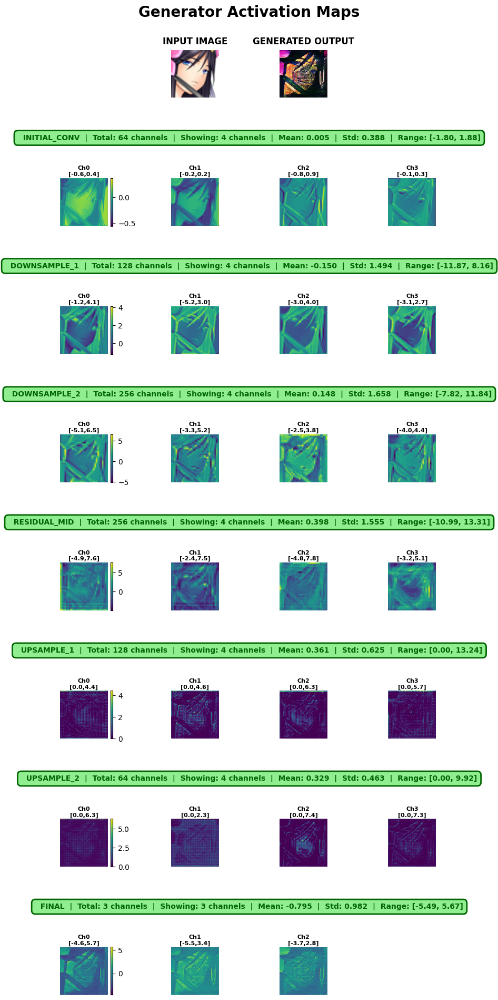


=== Feature Statistics ===

initial_conv:
  Shape: torch.Size([1, 64, 128, 128])
  Mean: 0.0051
  Std: 0.3878
  Range: [-1.8030, 1.8754]
  Sparsity: 0.00%

downsample_1:
  Shape: torch.Size([1, 128, 64, 64])
  Mean: -0.1495
  Std: 1.4941
  Range: [-11.8683, 8.1628]
  Sparsity: 0.00%

downsample_2:
  Shape: torch.Size([1, 256, 32, 32])
  Mean: 0.1476
  Std: 1.6578
  Range: [-7.8170, 11.8367]
  Sparsity: 0.00%

residual_mid:
  Shape: torch.Size([1, 256, 32, 32])
  Mean: 0.3978
  Std: 1.5547
  Range: [-10.9923, 13.3119]
  Sparsity: 0.00%

upsample_1:
  Shape: torch.Size([1, 128, 64, 64])
  Mean: 0.3613
  Std: 0.6255
  Range: [0.0000, 13.2397]
  Sparsity: 49.48%

upsample_2:
  Shape: torch.Size([1, 64, 128, 128])
  Mean: 0.3290
  Std: 0.4635
  Range: [0.0000, 9.9172]
  Sparsity: 40.51%

final:
  Shape: torch.Size([1, 3, 128, 128])
  Mean: -0.7955
  Std: 0.9823
  Range: [-5.4855, 5.6724]
  Sparsity: 0.00%


In [26]:
import torch
import torch.nn as nn
import matplotlib.pyplot as plt
import numpy as np
from torchvision import transforms
from PIL import Image
import os


class ActivationVisualizer:
    """
    Visualizes intermediate activations of a CycleGAN generator
    to understand what features the network is learning at different layers.
    """

    def __init__(self, generator, device='cuda' if torch.cuda.is_available() else 'cpu'):
        self.generator = generator
        self.device = device
        self.generator.eval()
        self.activations = {}
        self.hooks = []

    def register_hooks(self, layers_to_visualize='all'):
        """
        Register forward hooks to capture activations.

        Args:
            layers_to_visualize: 'all' or list of specific layer indices
        """
        self.activations = {}

        def get_activation(name):
            def hook(model, input, output):
                self.activations[name] = output.detach()
            return hook

        # Access the sequential model inside the generator
        model_layers = list(self.generator.model.children())

        if layers_to_visualize == 'all':
            # Register hooks for key layers
            layer_indices = {
                'initial_conv': 0,      # First conv layer
                'downsample_1': 3,      # After first downsample
                'downsample_2': 6,      # After second downsample
                'residual_mid': 12,     # Middle of residual blocks
                'upsample_1': 19,       # After first upsample
                'upsample_2': 22,       # After second upsample
                'final': -2             # Before final Tanh
            }
        else:
            layer_indices = layers_to_visualize

        for name, idx in layer_indices.items():
            layer = model_layers[idx]
            hook = layer.register_forward_hook(get_activation(name))
            self.hooks.append(hook)
            print(f"Registered hook for {name}: {layer.__class__.__name__}")

    def remove_hooks(self):
        """Remove all registered hooks."""
        for hook in self.hooks:
            hook.remove()
        self.hooks = []

    def visualize_activations(self, image_path, save_path=None, max_channels=16):
        """
        Generate and visualize activations for a single image.

        New layout:
        - Row 0: Original image and generated image (centered)
        - Row 1: Layer name/info for first layer
        - Row 2: Channel heatmaps for first layer
        - Row 3: Layer name/info for second layer
        - Row 4: Channel heatmaps for second layer
        - ... and so on

        Args:
            image_path: Path to input image
            save_path: Where to save visualization (optional)
            max_channels: Maximum number of channels to visualize per layer
        """
        # Load and preprocess image
        transform = transforms.Compose([
            transforms.Resize((128, 128)),
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
        ])

        image = Image.open(image_path).convert('RGB')
        input_tensor = transform(image).unsqueeze(0).to(self.device)

        # Forward pass
        with torch.no_grad():
            output = self.generator(input_tensor)

        # Create visualization
        num_layers = len(self.activations)
        # Each layer needs 2 rows: 1 for title, 1 for heatmaps
        # Plus 1 row at the top for input/output images
        num_rows = 1 + (num_layers * 2)
        num_cols = max_channels

        # More compact figure size - reduced height per layer
        fig = plt.figure(figsize=(2.5 * num_cols, 1.5 + 2.5 * num_layers))
        fig.suptitle('Generator Activation Maps', fontsize=20, fontweight='bold', y=0.996)

        # ============== ROW 0: INPUT AND OUTPUT IMAGES ==============
        # Calculate center position for the two images
        start_col = (max_channels - 2) // 2

        # Show original image (centered)
        ax_input = plt.subplot(num_rows, num_cols, start_col + 1)
        original_img = input_tensor.cpu().squeeze().permute(1, 2, 0).numpy()
        original_img = (original_img + 1) / 2  # Denormalize
        ax_input.imshow(np.clip(original_img, 0, 1))
        ax_input.set_title('INPUT IMAGE', fontsize=12, fontweight='bold', pad=8)
        ax_input.axis('off')

        # Show output (next to input)
        ax_output = plt.subplot(num_rows, num_cols, start_col + 2)
        output_img = output.cpu().squeeze().permute(1, 2, 0).numpy()
        output_img = (output_img + 1) / 2  # Denormalize
        ax_output.imshow(np.clip(output_img, 0, 1))
        ax_output.set_title('GENERATED OUTPUT', fontsize=12, fontweight='bold', pad=8)
        ax_output.axis('off')

        # ============== EACH LAYER GETS 2 ROWS ==============
        for layer_idx, (layer_name, activation) in enumerate(self.activations.items()):
            activation = activation.cpu().squeeze()  # Remove batch dimension
            total_channels = activation.shape[0]
            num_channels = min(total_channels, max_channels)

            # Calculate statistics for this layer
            act_np = activation.numpy()
            act_min, act_max = act_np.min(), act_np.max()
            act_mean, act_std = act_np.mean(), act_np.std()
            sparsity = (act_np == 0).mean()
            dead_channels = sum((activation[i].max() - activation[i].min()) < 1e-6
                              for i in range(total_channels))

            # Calculate row indices
            title_row = 1 + (layer_idx * 2)  # Row for title
            heatmap_row = title_row + 1       # Row for heatmaps

            # ===== TITLE ROW: Layer name and statistics =====
            # Span across all columns
            ax_title = plt.subplot(num_rows, 1, title_row + 1)
            ax_title.axis('off')

            # Create title text with statistics
            title_text = f'  {layer_name.upper()}  |  '
            title_text += f'Total: {total_channels} channels  |  '
            title_text += f'Showing: {num_channels} channels  |  '
            title_text += f'Mean: {act_mean:.3f}  |  '
            title_text += f'Std: {act_std:.3f}  |  '
            title_text += f'Range: [{act_min:.2f}, {act_max:.2f}]'

            # Add warnings
            warnings = []
            if sparsity > 0.5:
                warnings.append(f'{sparsity:.0%} zeros')
            if dead_channels > 0:
                warnings.append(f'{dead_channels} dead channels')

            if warnings:
                title_text += f'  |  ⚠️ WARNING: {", ".join(warnings)}'

            # Style with color coding
            if warnings:
                bg_color = 'lightcoral'
                edge_color = 'darkred'
                text_color = 'darkred'
            else:
                bg_color = 'lightgreen'
                edge_color = 'darkgreen'
                text_color = 'darkgreen'

            ax_title.text(0.5, 0.5, title_text,
                         ha='center', va='center',
                         fontsize=10,
                         fontweight='bold',
                         color=text_color,
                         bbox=dict(boxstyle='round,pad=0.5',
                                 facecolor=bg_color,
                                 edgecolor=edge_color,
                                 linewidth=2))

            # ===== HEATMAP ROW: Channel activations =====
            for ch in range(num_channels):
                ax = plt.subplot(num_rows, num_cols, heatmap_row * num_cols + ch + 1)

                channel_activation = activation[ch].numpy()

                # Check if this channel is dead
                ch_min, ch_max = channel_activation.min(), channel_activation.max()
                is_dead = (ch_max - ch_min) < 1e-6

                # Choose colormap
                if is_dead:
                    cmap = 'Greys'
                    title_color = 'red'
                else:
                    cmap = 'viridis'
                    title_color = 'black'

                # Plot the heatmap
                im = ax.imshow(channel_activation, cmap=cmap,
                              vmin=ch_min, vmax=ch_max)

                # Title for channel - more compact
                if is_dead:
                    title = f'Ch{ch}\n⚠️DEAD'
                else:
                    title = f'Ch{ch}\n[{ch_min:.1f},{ch_max:.1f}]'

                ax.set_title(title, fontsize=8, color=title_color, fontweight='bold', pad=3)
                ax.axis('off')

                # Add colorbar for first channel only
                if ch == 0:
                    from mpl_toolkits.axes_grid1 import make_axes_locatable
                    divider = make_axes_locatable(ax)
                    cax = divider.append_axes("right", size="5%", pad=0.05)
                    plt.colorbar(im, cax=cax)

        plt.tight_layout(rect=[0, 0, 1, 0.995], h_pad=0.5, w_pad=0.5)

        if save_path:
            plt.savefig(save_path, dpi=150, bbox_inches='tight')
            print(f"Visualization saved to {save_path}")

        plt.show()

        return self.activations

    def analyze_feature_statistics(self, image_path):
        """
        Analyze statistical properties of activations across layers.

        Returns a dictionary with mean, std, sparsity for each layer.
        """
        # Load and preprocess image
        transform = transforms.Compose([
            transforms.Resize((128, 128)),
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
        ])

        image = Image.open(image_path).convert('RGB')
        input_tensor = transform(image).unsqueeze(0).to(self.device)

        # Forward pass
        with torch.no_grad():
            output = self.generator(input_tensor)

        stats = {}
        for layer_name, activation in self.activations.items():
            act = activation.cpu().numpy()
            stats[layer_name] = {
                'mean': float(np.mean(act)),
                'std': float(np.std(act)),
                'min': float(np.min(act)),
                'max': float(np.max(act)),
                'sparsity': float(np.mean(act == 0)),  # Percentage of zero activations
                'shape': activation.shape
            }

        return stats

    def visualize_layer_summary(self, image_path, save_path=None):
        """
        Create a simplified summary view showing average activation per layer.
        Much easier to interpret than individual channels.

        Args:
            image_path: Path to input image
            save_path: Where to save visualization
        """
        # Load and preprocess image
        transform = transforms.Compose([
            transforms.Resize((128, 128)),
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
        ])

        image = Image.open(image_path).convert('RGB')
        input_tensor = transform(image).unsqueeze(0).to(self.device)

        # Forward pass
        with torch.no_grad():
            output = self.generator(input_tensor)

        # Create simpler visualization
        num_layers = len(self.activations)
        fig, axes = plt.subplots(2, num_layers + 1, figsize=(4 * (num_layers + 1), 8))

        fig.suptitle('Generator Layer Summary - Average Activations',
                    fontsize=16, fontweight='bold')

        # Show input
        ax = axes[0, 0]
        original_img = input_tensor.cpu().squeeze().permute(1, 2, 0).numpy()
        original_img = (original_img + 1) / 2
        ax.imshow(np.clip(original_img, 0, 1))
        ax.set_title('INPUT', fontweight='bold')
        ax.axis('off')

        # Show output
        ax = axes[1, 0]
        output_img = output.cpu().squeeze().permute(1, 2, 0).numpy()
        output_img = (output_img + 1) / 2
        ax.imshow(np.clip(output_img, 0, 1))
        ax.set_title('OUTPUT', fontweight='bold')
        ax.axis('off')

        # Show each layer's average activation
        for layer_idx, (layer_name, activation) in enumerate(self.activations.items(), 1):
            activation = activation.cpu().squeeze()

            # Average across all channels
            avg_activation = activation.mean(dim=0).numpy()
            max_activation = activation.max(dim=0)[0].numpy()

            # Statistics
            act_np = activation.numpy()
            act_min, act_max = act_np.min(), act_np.max()
            act_mean, act_std = act_np.mean(), act_np.std()
            sparsity = (act_np == 0).mean()
            dead_channels = sum((act.max() - act.min()) < 1e-6 for act in activation)

            # Top row: Average activation
            ax = axes[0, layer_idx]
            im = ax.imshow(avg_activation, cmap='viridis')
            ax.set_title(f'{layer_name}\nAverage', fontsize=10)
            ax.axis('off')
            plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)

            # Bottom row: Max activation
            ax = axes[1, layer_idx]
            im = ax.imshow(max_activation, cmap='hot')
            ax.set_title(f'Max\n({activation.shape[0]} channels)', fontsize=9)
            ax.axis('off')
            plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)

            # Add text with statistics
            stats_text = f'μ={act_mean:.2f}, σ={act_std:.2f}\n'
            stats_text += f'range=[{act_min:.2f}, {act_max:.2f}]\n'
            if sparsity > 0.3:
                stats_text += f'⚠️ {sparsity:.0%} zeros\n'
            if dead_channels > 0:
                stats_text += f'⚠️ {dead_channels} dead channels'

            ax.text(0.5, -0.15, stats_text,
                   transform=ax.transAxes,
                   ha='center', va='top',
                   fontsize=8,
                   bbox=dict(boxstyle='round', facecolor='yellow', alpha=0.3))

        plt.tight_layout()

        if save_path:
            plt.savefig(save_path, dpi=150, bbox_inches='tight')
            print(f"Summary visualization saved to {save_path}")

        plt.show()

    def compare_multiple_images(self, image_paths, save_path=None):
        """
        Compare activations across multiple images to see consistency.

        Args:
            image_paths: List of paths to input images
            save_path: Where to save comparison visualization
        """
        fig, axes = plt.subplots(len(image_paths), len(self.activations) + 2,
                                figsize=(20, 4 * len(image_paths)))

        transform = transforms.Compose([
            transforms.Resize((128, 128)),
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
        ])

        for img_idx, img_path in enumerate(image_paths):
            # Load image
            image = Image.open(img_path).convert('RGB')
            input_tensor = transform(image).unsqueeze(0).to(self.device)

            # Forward pass
            with torch.no_grad():
                output = self.generator(input_tensor)

            # Show input
            ax = axes[img_idx, 0] if len(image_paths) > 1 else axes[0]
            original_img = input_tensor.cpu().squeeze().permute(1, 2, 0).numpy()
            original_img = (original_img + 1) / 2
            ax.imshow(np.clip(original_img, 0, 1))
            ax.set_title(f'Input {img_idx + 1}')
            ax.axis('off')

            # Show output
            ax = axes[img_idx, 1] if len(image_paths) > 1 else axes[1]
            output_img = output.cpu().squeeze().permute(1, 2, 0).numpy()
            output_img = (output_img + 1) / 2
            ax.imshow(np.clip(output_img, 0, 1))
            ax.set_title(f'Output {img_idx + 1}')
            ax.axis('off')

            # Show average activation for each layer
            for layer_idx, (layer_name, activation) in enumerate(self.activations.items(), 2):
                ax = axes[img_idx, layer_idx] if len(image_paths) > 1 else axes[layer_idx]

                # Average across all channels
                avg_activation = activation.cpu().squeeze().mean(dim=0).numpy()
                im = ax.imshow(avg_activation, cmap='viridis')
                ax.set_title(layer_name if img_idx == 0 else '')
                ax.axis('off')

        plt.tight_layout()

        if save_path:
            plt.savefig(save_path, dpi=150, bbox_inches='tight')
            print(f"Comparison saved to {save_path}")

        plt.show()


def visualize_filter_response(generator, layer_index, filter_index, device='cuda'):
    """
    Visualize what a specific filter in a specific layer responds to
    by generating an input that maximally activates that filter.

    This is more advanced - using gradient ascent to find optimal input.
    """
    generator.eval()

    # Create random input
    input_tensor = torch.randn(1, 3, 128, 128).to(device)
    input_tensor.requires_grad = True

    # Hook to capture specific filter activation
    activation = {}

    def get_activation(name):
        def hook(model, input, output):
            activation[name] = output
        return hook

    model_layers = list(generator.model.children())
    hook = model_layers[layer_index].register_forward_hook(get_activation('target'))

    optimizer = torch.optim.Adam([input_tensor], lr=0.1)

    # Gradient ascent
    for i in range(100):
        optimizer.zero_grad()

        _ = generator(input_tensor)

        # Maximize the activation of specific filter
        loss = -activation['target'][0, filter_index].mean()
        loss.backward()
        optimizer.step()

        # Normalize to prevent explosion
        with torch.no_grad():
            input_tensor.data = torch.clamp(input_tensor.data, -1, 1)

    hook.remove()

    # Visualize the result
    result = input_tensor.detach().cpu().squeeze().permute(1, 2, 0).numpy()
    result = (result + 1) / 2

    plt.figure(figsize=(6, 6))
    plt.imshow(np.clip(result, 0, 1))
    plt.title(f'Pattern that activates Layer {layer_index}, Filter {filter_index}')
    plt.axis('off')
    plt.show()

    return result


# Example usage function
def analyze_generator(checkpoint_path, test_image_path, output_dir='./visualizations'):
    """
    Main function to analyze a trained generator.

    Args:
        checkpoint_path: Path to saved model checkpoint
        test_image_path: Path to test image
        output_dir: Directory to save visualizations
    """
    os.makedirs(output_dir, exist_ok=True)

    # Import your Generator class (assuming it's in the same file or imported)
    device = 'cuda' if torch.cuda.is_available() else 'cpu'

    # Load the trained model
    cyclegan = CycleGAN(device=device)
    cyclegan.load_models(checkpoint_path)

    # Create visualizer for the normal2pixel generator
    visualizer = ActivationVisualizer(cyclegan.G_normal2pixel, device=device)
    visualizer.register_hooks('all')

    print("\n=== Visualizing Activations ===")
    activations = visualizer.visualize_activations(
        test_image_path,
        save_path=os.path.join(output_dir, 'activations.png'),
        max_channels=4
    )

    print("\n=== Feature Statistics ===")
    stats = visualizer.analyze_feature_statistics(test_image_path)
    for layer_name, layer_stats in stats.items():
        print(f"\n{layer_name}:")
        print(f"  Shape: {layer_stats['shape']}")
        print(f"  Mean: {layer_stats['mean']:.4f}")
        print(f"  Std: {layer_stats['std']:.4f}")
        print(f"  Range: [{layer_stats['min']:.4f}, {layer_stats['max']:.4f}]")
        print(f"  Sparsity: {layer_stats['sparsity']:.2%}")

    visualizer.remove_hooks()

    return visualizer, stats


if __name__ == "__main__":
    # Example usage
    BASE_PATH = "/content/drive/MyDrive/Proyecto FaceToPix"
    CHECKPOINT_PATH = f"{BASE_PATH}/checkpoints/checkpoint_epoch_50.pth"
    TEST_IMAGE_PATH = f"{BASE_PATH}/data/faces/8.png"

    visualizer, stats = analyze_generator(CHECKPOINT_PATH, TEST_IMAGE_PATH)